# Assignment 4 of Sai Durga Mahesh Bandaru

## Problem Description

A store wants to run a campaign that offers 20% discount for 400 to 999 dollars to only valid  existing customers, we need to build a **predictive model** that will predict which customer will purchase the discount offer (gold membership)

All the variables are based on what the customer did in the past 2 years

Dataset is taken from kaggle: https://www.kaggle.com/datasets/ahsan81/superstore-marketing-campaign-dataset

**Columns:**    <br>

complaints is 1 if customer made a complaint in the last two years, <br>

MntWines is amount spent on wines in the past 2 years in dollars. <br>


recency is the number of days since last purchase. <br>

respone (targets) is 1 if customer accepted the offer in the last campaign<br>

Year_Birth is year in which customer is born <br>

Education is degree of customer<br>

Marital_Status indicates martial status of customer <br>

kidhome and teenhome represents number of kids and teens in customer house <br>

NumDealsPurchases, NumWebPurchases, NumCatalogPurchases and NumStorePurchases represents number of purchases made from deals, website, catalog and store respectively<br>
    

# Abstract


The aim of the Notebook is performing Data Cleaning, Feature Selection, Modeling, and model interpretation on the above dataset

1. Section 1: Data Cleaning and EDA
    - Understanding columns
    - Identifying distributions
    - Handling missing values and outliers
2. Modelling and Interpretation
    - Training linear and tree based models
    - interpretation of models using LIME and SHAP values
3. Using AutoML to find the best classifier and interpret the explanation of AutoML
    - Train auto ml model to identify best model and interpret results of best model
    - Re-training the model without outliers and observing the affect

In [6]:
! pip install shap
import shap

! pip install lime

import lime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [7]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pylab as plt
from matplotlib import pyplot

In [8]:
df = pd.read_csv(
    'https://raw.githubusercontent.com/maheshsai252/DatasetsForDSCourse/main/superstore_data.csv'
)

# EDA and Data Cleaning

### Fetching high level info and data types of our data


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 22 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Id                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

### we have 3 Different data types in our dataset, int64, float64 and object

# Initial glance of numerical and categorical columns based on data type

### Numerical columns


In [10]:
# Fetching numerical and categorical columns directly based on dtype inside data frame
cols = df.columns
num_cols = df._get_numeric_data().columns
num_cols

Index(['Id', 'Year_Birth', 'Income', 'Kidhome', 'Teenhome', 'Recency',
       'MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts',
       'MntSweetProducts', 'MntGoldProds', 'NumDealsPurchases',
       'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases',
       'NumWebVisitsMonth', 'Response', 'Complain'],
      dtype='object')

### Categorical columns

In [11]:
cat_cols=list(set(cols) - set(num_cols))
cat_cols

['Dt_Customer', 'Education', 'Marital_Status']

# Feature Engineering

## Understanding Missing values

In [12]:
#find columns with missing values by comparing original number and reduced number after dropping na columns
def c_missing(df):
    
    c_list = list()
    
    for c in df.columns:
        c_list.append(len(df[c].dropna()))
    
    m_cols = list(df.columns[c_list < np.max(c_list)])
    
    print(f'There are {len(m_cols)} columns missing.\nHere is the list: {m_cols}\n')    
        
    return m_cols

In [13]:
m_cols=c_missing(df)
m_cols

There are 1 columns missing.
Here is the list: ['Income']



['Income']

In [14]:
print(f'{df[df[m_cols].isna().any(axis=1)].shape[0]} rows has missing values')

24 rows has missing values


## Percentage of data having missing values

In [15]:
df[df[m_cols].isna().any(axis=1)].shape[0]/len(df) *100

1.0714285714285714

In [16]:
df.isnull().sum()

Id                      0
Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
Response                0
Complain                0
dtype: int64

## Handling date column

DT_customer is the date customer joined into system. Seperating the date into day, month and year can enhance our analysis. For example, customers joined in december month because of certain conditions can take up the existing offer  


In [17]:

df['Dt_Customer'] = pd.to_datetime(df['Dt_Customer'], errors='coerce')

df['dt_year'] = df['Dt_Customer'].dt.year
df['dt_month'] = df['Dt_Customer'].dt.month
df['dt_day'] = df['Dt_Customer'].dt.day


In [18]:
df.head()

,Id,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Response,Complain,dt_year,dt_month,dt_day
0,1826,1970,Graduation,Divorced,84835.0,0,0,2014-06-16,0,189,...,1,4,4,6,1,1,0,2014,6,16
1,1,1961,Graduation,Single,57091.0,0,0,2014-06-15,0,464,...,1,7,3,7,5,1,0,2014,6,15
2,10476,1958,Graduation,Married,67267.0,0,1,2014-05-13,0,134,...,1,3,2,5,2,0,0,2014,5,13
3,1386,1967,Graduation,Together,32474.0,1,1,2014-11-05,0,10,...,1,1,0,2,7,0,0,2014,11,5
4,5371,1989,Graduation,Single,21474.0,1,0,2014-08-04,0,6,...,2,3,1,2,7,1,0,2014,8,4


### Removing actual date column after separation into day, month and year colunms to avaoid redundancy of data


In [19]:
df = df.drop(['Dt_Customer'], axis=1)
df.head()

,Id,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,...,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Response,Complain,dt_year,dt_month,dt_day
0,1826,1970,Graduation,Divorced,84835.0,0,0,0,189,104,...,1,4,4,6,1,1,0,2014,6,16
1,1,1961,Graduation,Single,57091.0,0,0,0,464,5,...,1,7,3,7,5,1,0,2014,6,15
2,10476,1958,Graduation,Married,67267.0,0,1,0,134,11,...,1,3,2,5,2,0,0,2014,5,13
3,1386,1967,Graduation,Together,32474.0,1,1,0,10,0,...,1,1,0,2,7,0,0,2014,11,5
4,5371,1989,Graduation,Single,21474.0,1,0,0,6,16,...,2,3,1,2,7,1,0,2014,8,4


##  Numerical and Categorical Columns after understanding data

### Numerical columns

In [20]:
num_cols = df._get_numeric_data().columns
num_cols

Index(['Id', 'Year_Birth', 'Income', 'Kidhome', 'Teenhome', 'Recency',
       'MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts',
       'MntSweetProducts', 'MntGoldProds', 'NumDealsPurchases',
       'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases',
       'NumWebVisitsMonth', 'Response', 'Complain', 'dt_year', 'dt_month',
       'dt_day'],
      dtype='object')

In [21]:
num_cols = ['Id','Income', 'Recency',
       'MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts',
       'MntSweetProducts', 'MntGoldProds', 'NumDealsPurchases',
       'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases',
       'NumWebVisitsMonth']

In [22]:
for i in ['Kidhome','Year_Birth', 'dt_year', 'dt_month',
       'dt_day', 'Teenhome','Marital_Status', 'Education','Complain']:
    print("value counts of ",i)
    print()
    print(df[i].value_counts())
    print()

value counts of  Kidhome

0    1293
1     899
2      48
Name: Kidhome, dtype: int64

value counts of  Year_Birth

1976    89
1971    87
1975    83
1972    79
1970    77
1978    77
1965    74
1973    74
1969    71
1974    69
1956    55
1979    53
1958    53
1952    52
1977    52
1959    51
1968    51
1966    50
1954    50
1955    49
1960    49
1982    45
1963    45
1967    44
1962    44
1957    43
1951    43
1964    42
1983    42
1986    42
1980    39
1981    39
1984    38
1961    36
1953    35
1985    32
1989    30
1949    30
1950    29
1988    29
1987    27
1948    21
1990    18
1947    16
1946    16
1991    15
1992    13
1945     8
1944     7
1943     7
1993     5
1995     5
1994     3
1996     2
1893     1
1899     1
1941     1
1940     1
1900     1
Name: Year_Birth, dtype: int64

value counts of  dt_year

2013    1189
2014     557
2012     494
Name: dt_year, dtype: int64

value counts of  dt_month

8     211
10    209
3     202
12    202
5     192
1     191
2     187
11    185
4   

## Even though kidhome and teen home looked like continuous variables, their values are distributed between 0, 1 and 2

## Also Year_Birth, dt_day, dt_month, dt_year are all nominal as they take value from fixed set.

## Since these values are discrete, these variables can be considered categorical

## Final Categorical Colmns

In [23]:
cols=df.columns
cat_cols=list(set(cols) - set(num_cols))
cat_cols

['dt_day',
 'dt_month',
 'Kidhome',
 'Year_Birth',
 'dt_year',
 'Marital_Status',
 'Education',
 'Response',
 'Teenhome',
 'Complain']

# Identifying distributions of numerical variables

# Q-Q Plot for finding distributions of numerical variables

In [24]:
from statsmodels.graphics.gofplots import qqplot
num_cols=list(num_cols)
num_cols= num_cols[:]

 ### Taking numerical columns only

In [25]:
data_norm=df[num_cols]


In [26]:
data_norm=data_norm.dropna()

## Q-Q plots of numerical columns

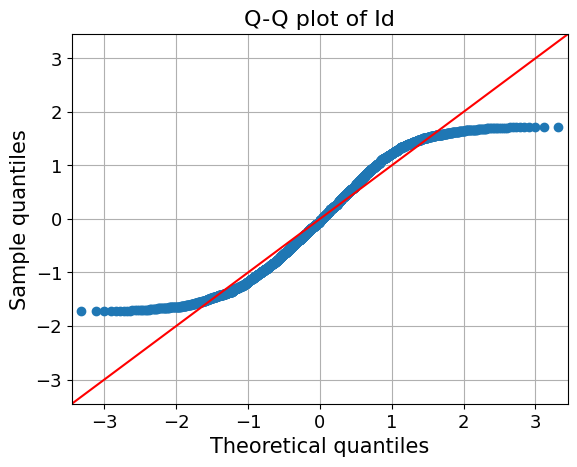

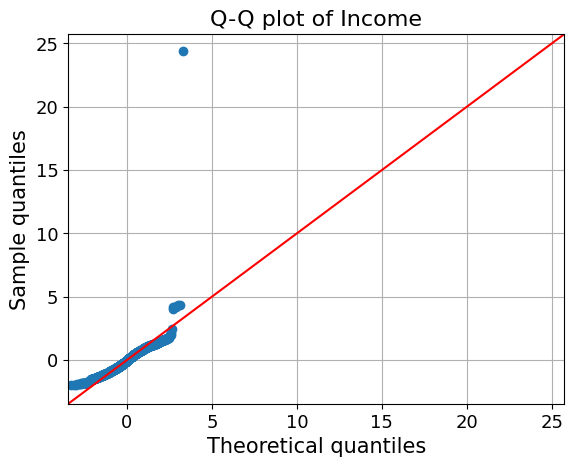

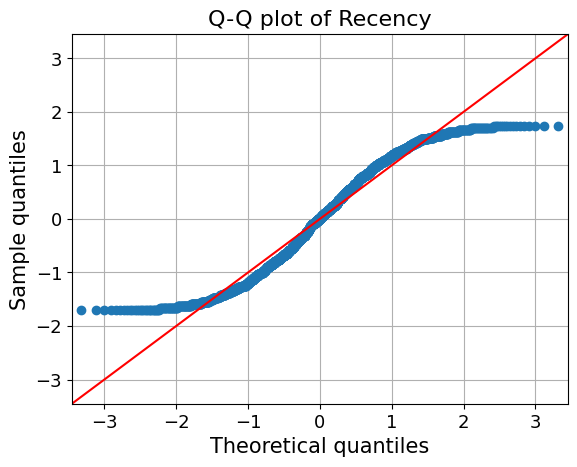

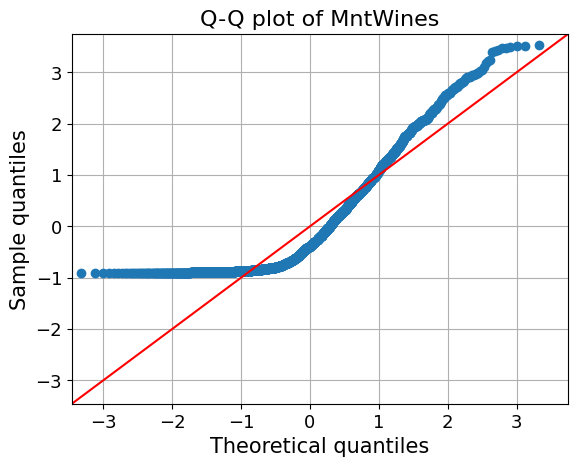

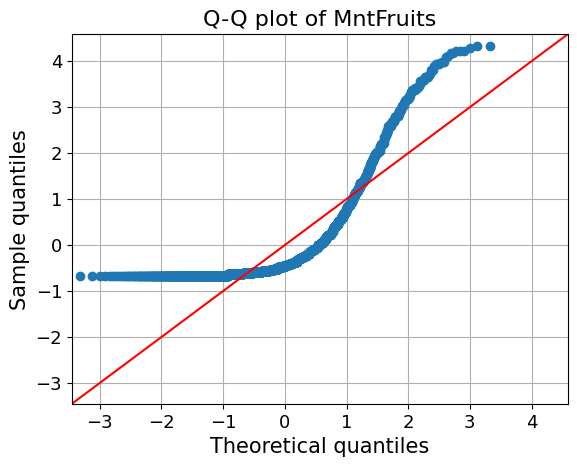

...

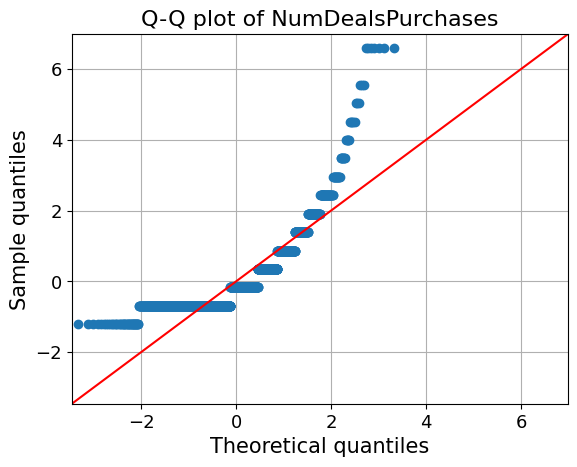

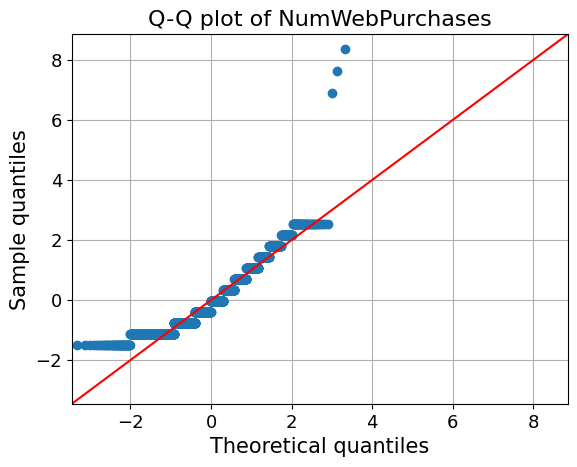

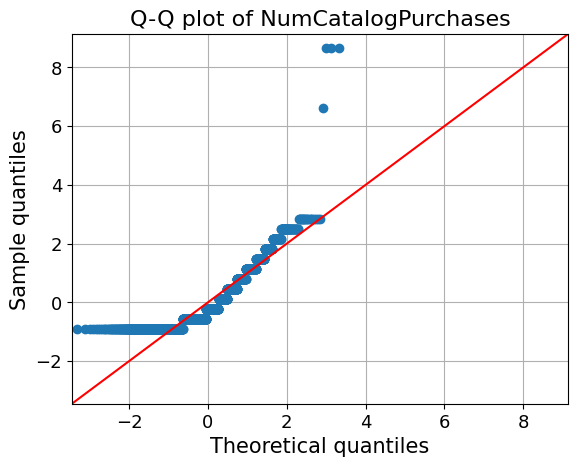

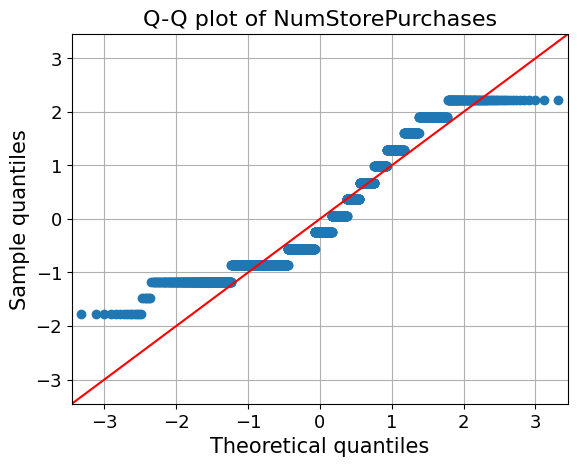

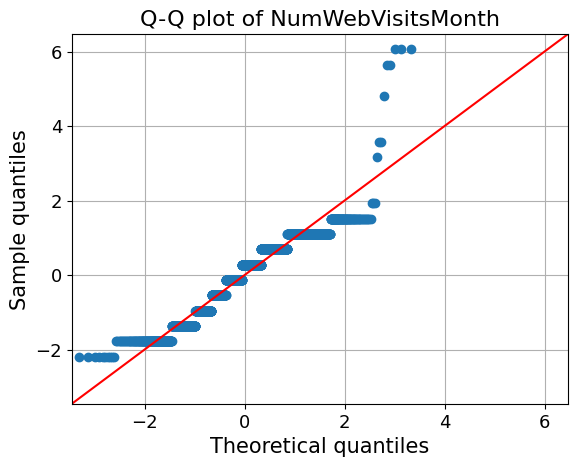

In [27]:
for c in data_norm.columns[:]:
#   plt.figure(figsize=(20,5))
  fig=qqplot(data_norm[c],line='45',fit='True')
  plt.xticks(fontsize=13)
  plt.yticks(fontsize=13)
  plt.xlabel("Theoretical quantiles",fontsize=15)
  plt.ylabel("Sample quantiles",fontsize=15)
  plt.title("Q-Q plot of {}".format(c),fontsize=16)
  plt.grid(True)
  plt.show()

### Number of Unique ids 

In [28]:
data_norm['Id'].nunique()


2216

In [29]:
data_norm.shape

(2216, 14)

**Looking at value counts of recency**

In [30]:
data_norm['Recency'].value_counts()

56    37
54    32
30    32
46    31
92    30
      ..
5     15
59    14
22    13
7     12
44    11
Name: Recency, Length: 100, dtype: int64

## Id is a nominal variable that uniquely identifies a row

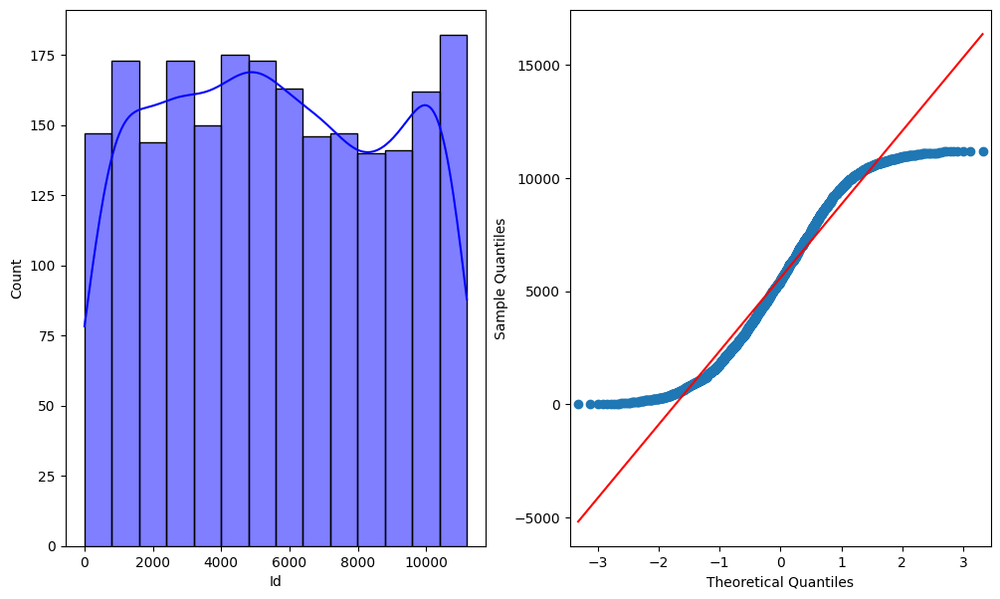

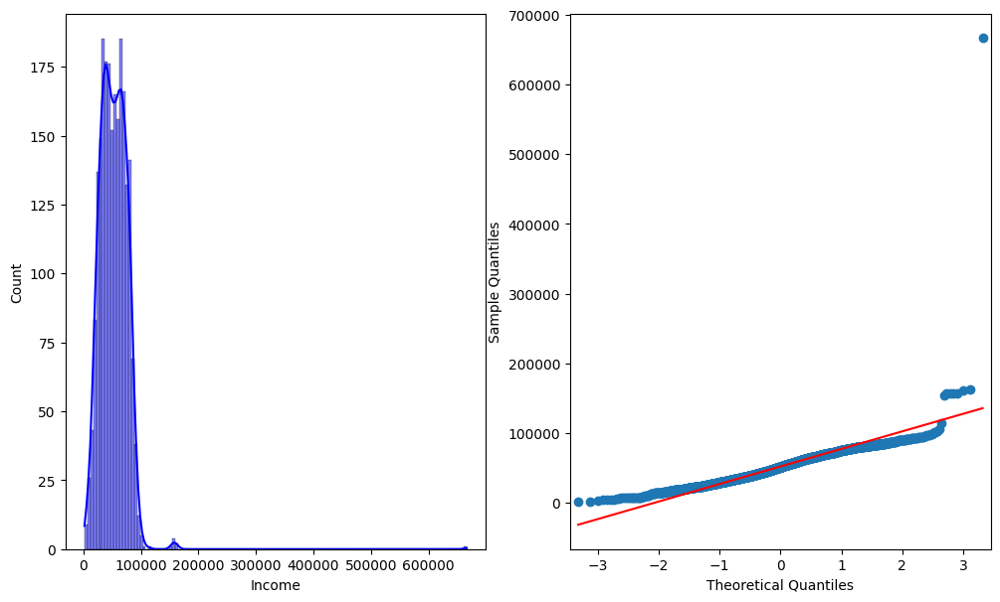

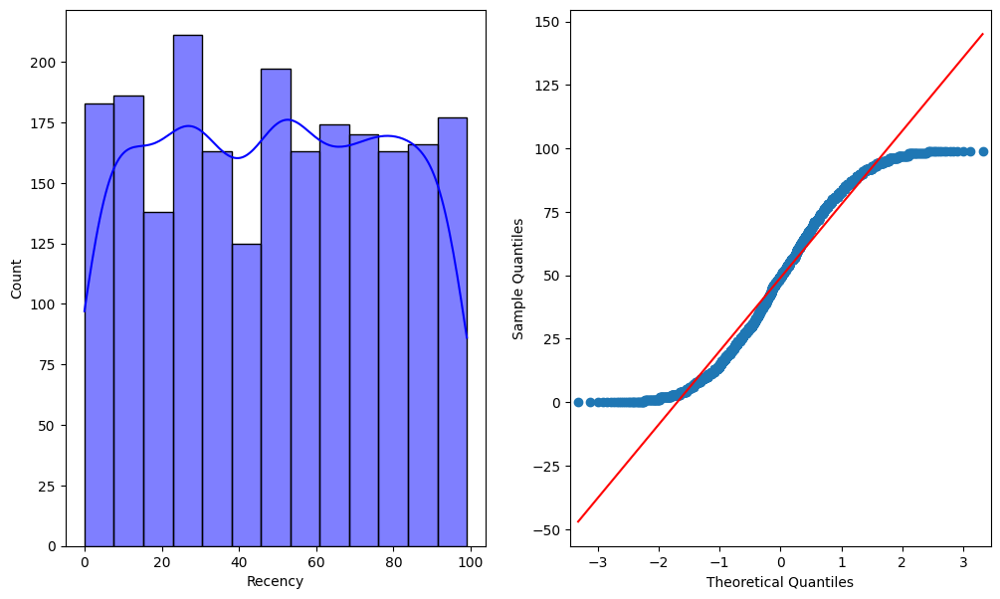

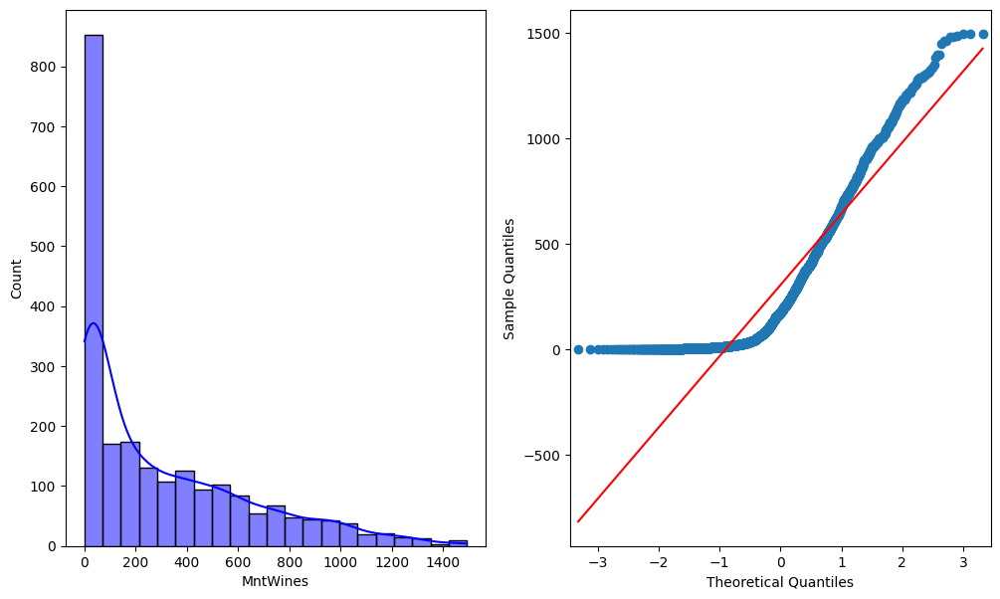

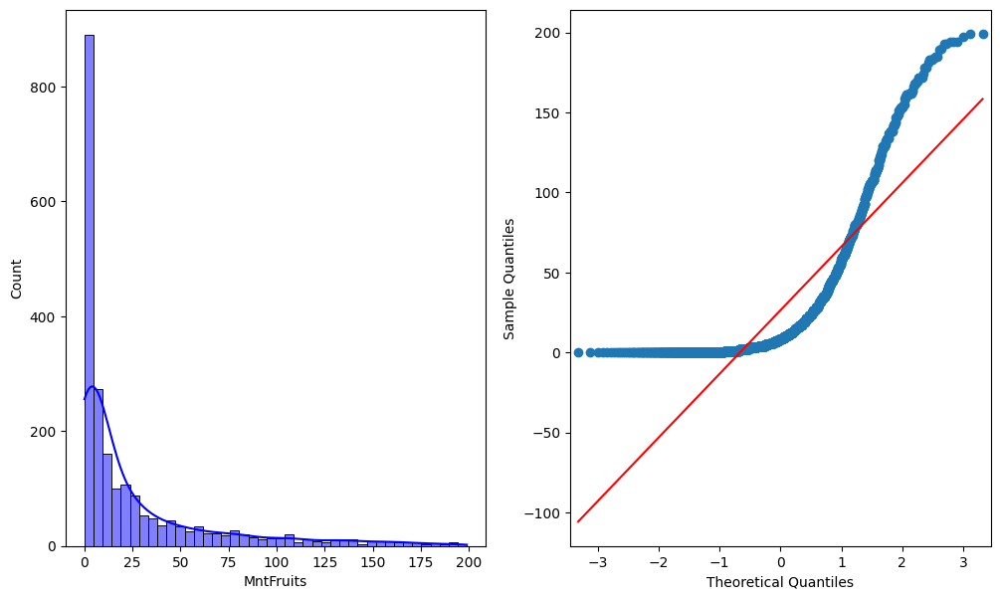

...

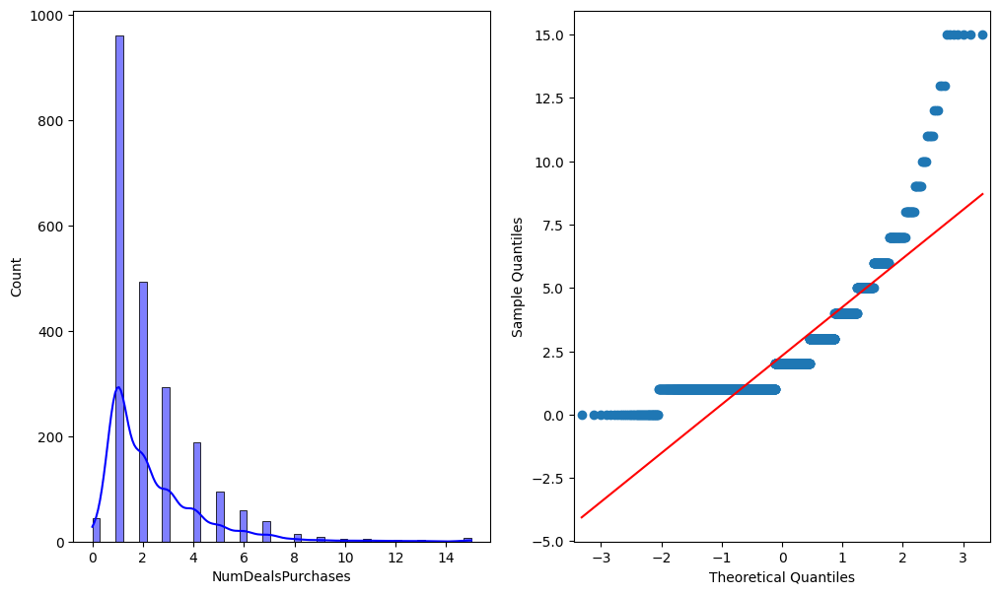

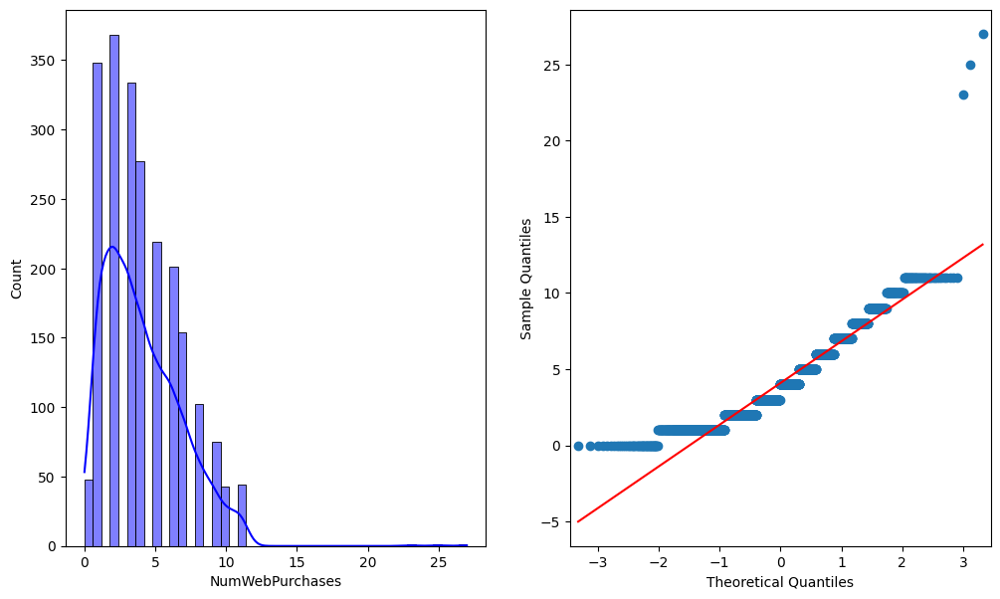

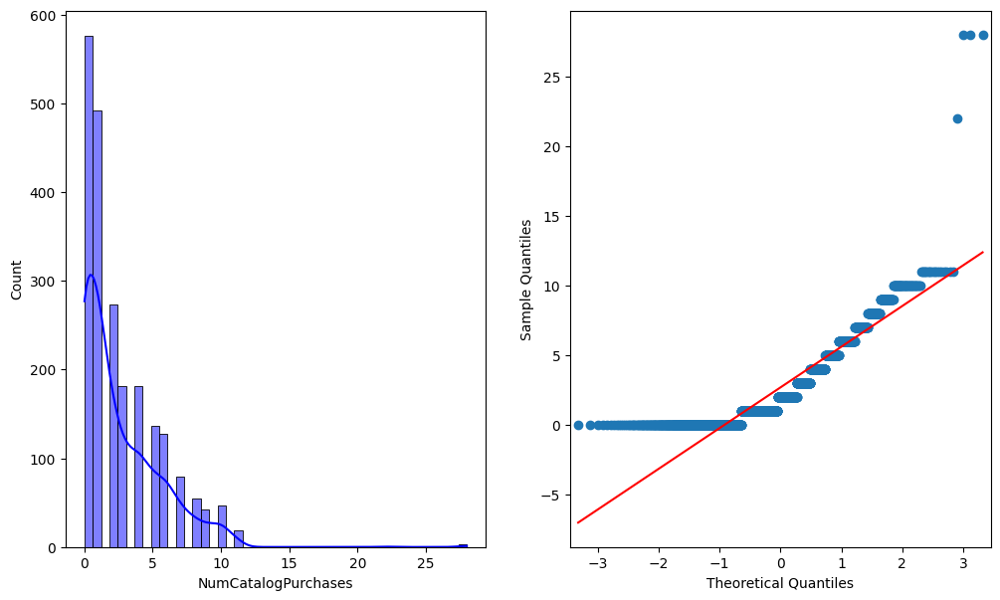

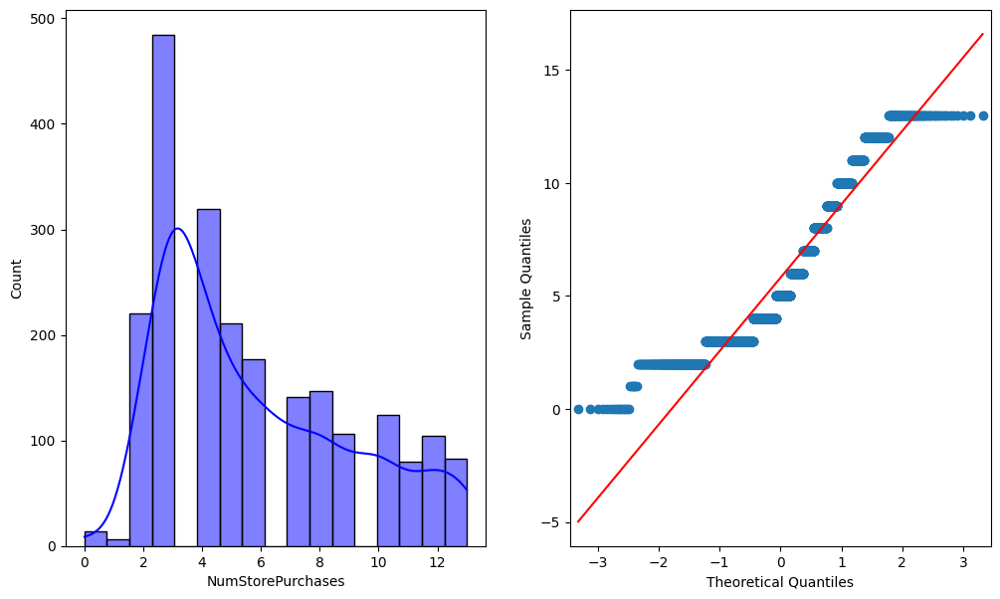

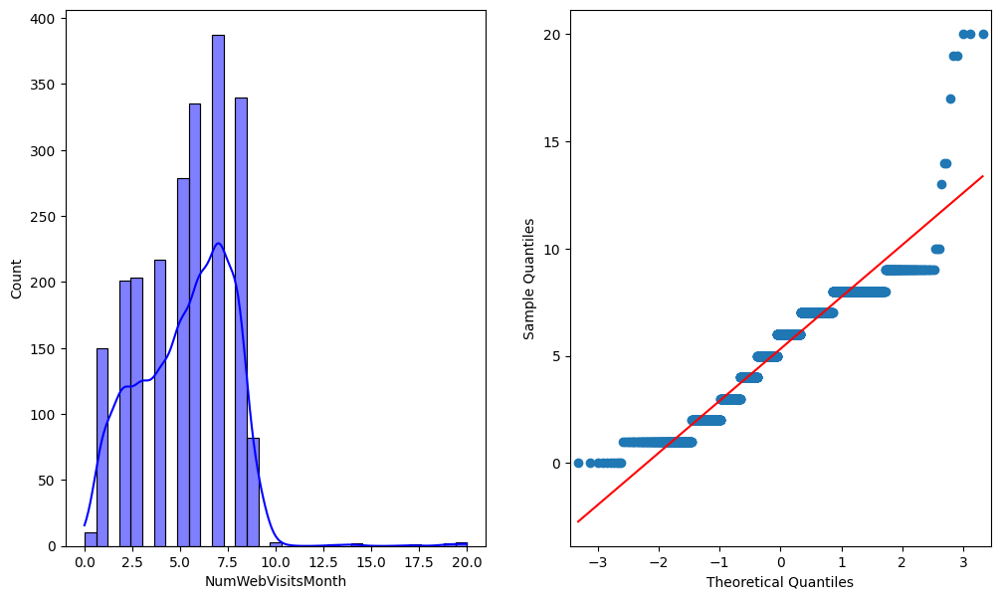

In [31]:
import seaborn as sns
import statsmodels.graphics.gofplots as sm

for c in data_norm.columns[:]:
    fig, ax = plt.subplots(1, 2, figsize=(12, 7))

    sns.histplot(data_norm[c],kde=True, color ='blue', ax=ax[0])
    sm.ProbPlot(data_norm[c]).qqplot(line='s', ax=ax[1])


**It appears that all independent variables are roughly following normal distribution**

**Majority of columns consists of outliers**

## Because of significant outliers, the following variables seems skewed right

**MntFruits, MntMeatProducts, MntFishProducts, MntSweetProducts,MntGoldProducts, MntWines, NumDealsPurchases, NumWebPurchases,NumCatalogPurchases, NumStorePurchases, NumWebVisitsMonth**


**Recency - has only 100 unique values and the distribution is roughly uniform with few outliers**

# Histograms of categorical columns

In [32]:
#histograms for numerical data
def plot_num(c_in):
   
    hist, edges = np.histogram(c_in.dropna(), density=True, bins=50)
    
    f = figure(title = c_in.name)
    
    f.quad(top=hist, bottom = 0, fill_color="navy", left=edges[:-1]
           , right=edges[1:], alpha=0.5, line_color="white")
    
    return f

#histograms for categorical data
def plot_cat(c_in):
    
    plot_df = c_in.dropna().value_counts().reset_index()
    
    plot_df.columns = [c_in.name, 'n']
    
    f = figure(x_range = plot_df[c_in.name], title = c_in.name)
    
    f.vbar(x=plot_df[c_in.name], top=plot_df['n'], width = .05
           , fill_color="navy", alpha=0.5, line_color="white")
    
    return f

In [33]:
def plot_data(c_num, c_cat):
    
    
    list_plots = list()
    
    # Iterate through all numerical columns
    for c in c_num:
        list_plots.append(plot_num(df[c]))
        
    # Loop through all categorical columns
    for c in c_cat:
        list_plots.append(plot_cat(df[c]))
    
    # returns the list of plots
    return list_plots

In [34]:
from bokeh.embed import components
from bokeh.plotting import figure
from bokeh.io import output_file, show, save,output_notebook
from bokeh.layouts import gridplot
from bokeh.resources import INLINE
from bokeh.models import (ColumnDataSource, CDSView, GroupFilter, 
                          HoverTool, PanTool, ZoomInTool, ZoomOutTool, 
                          ResetTool, DatetimeTickFormatter, CustomJS,
                          NumeralTickFormatter, CrosshairTool, TapTool,
                          MultiLine, FactorRange, SingleIntervalTicker)
# Loading Bokeh
output_notebook(INLINE)

show(gridplot(plot_data(['Year_Birth', 'Recency','dt_day','dt_year', 'dt_month',
       'dt_day'], ['Marital_Status', 'Education']), ncols=1))


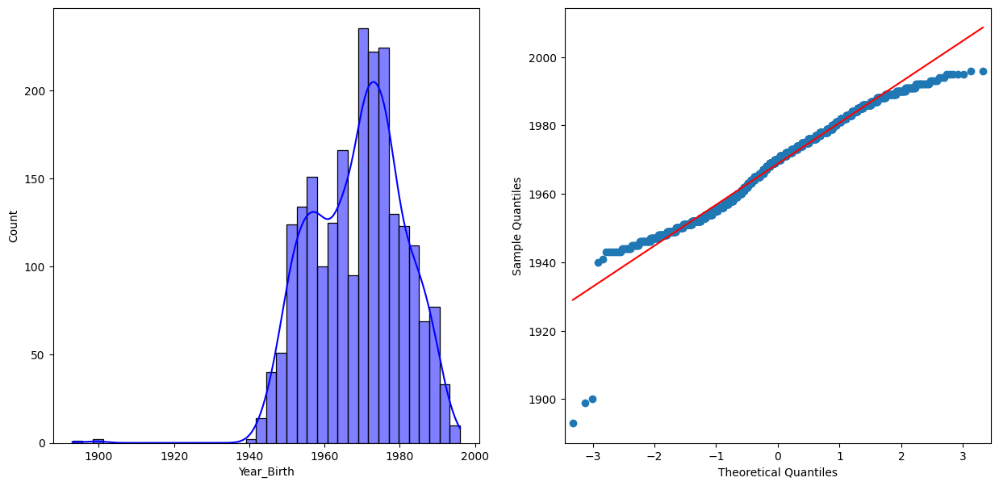

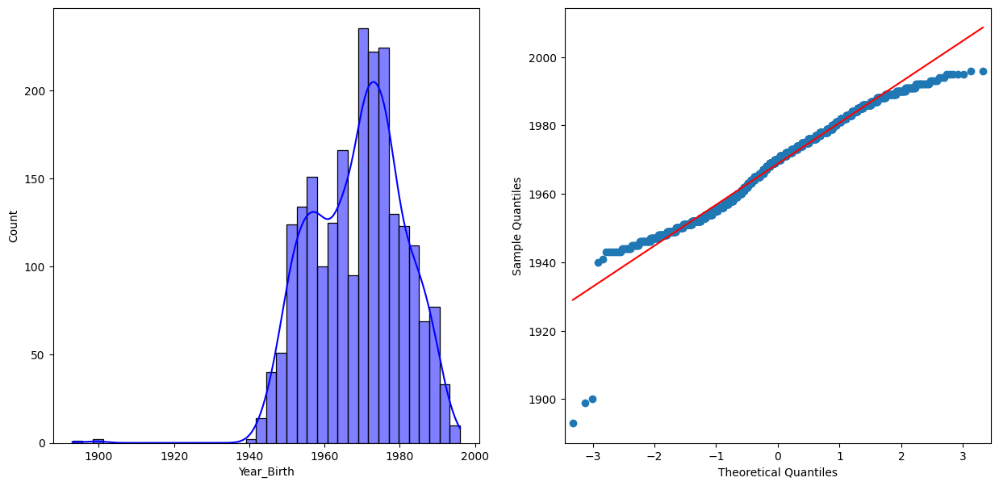

In [35]:
fig, ax = plt.subplots(1, 2, figsize=(15, 7))

sns.histplot(df['Year_Birth'],kde=True, color ='blue', ax=ax[0])
sm.ProbPlot(df['Year_Birth']).qqplot(line='s', ax=ax[1])

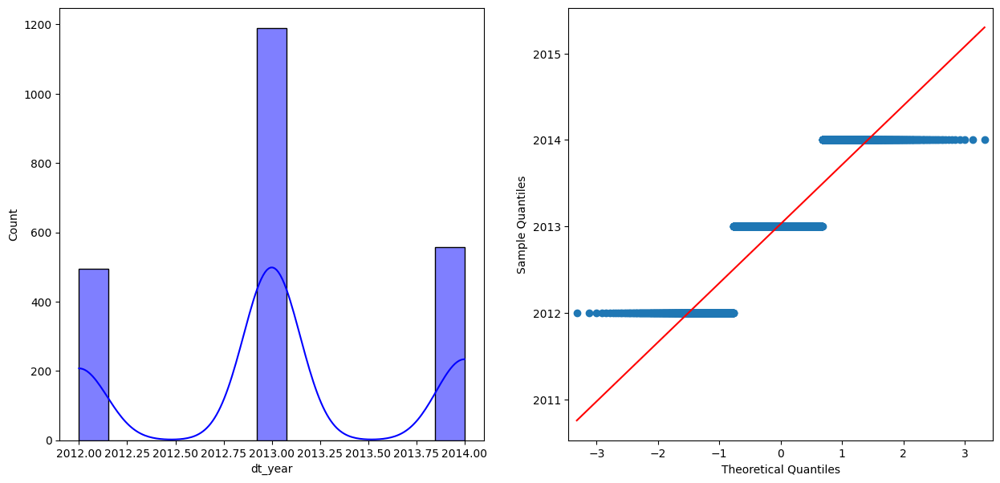

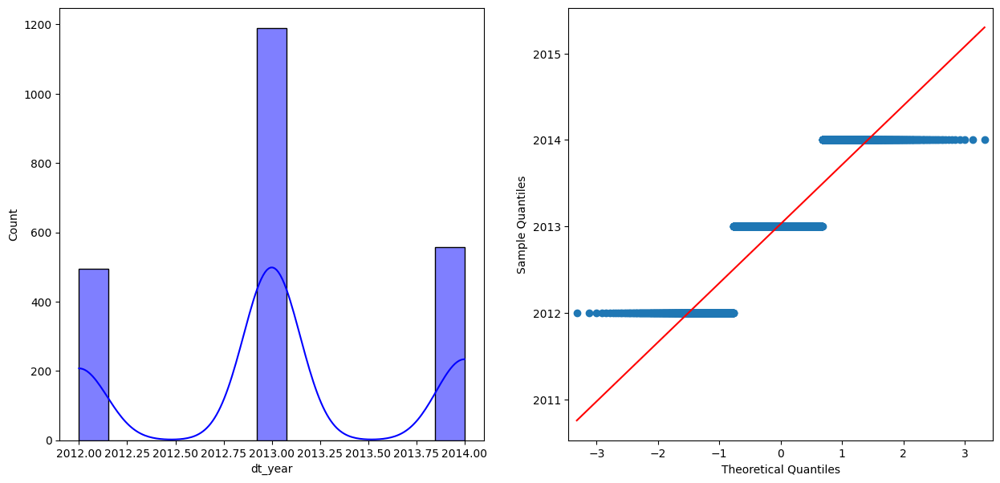

In [36]:
fig, ax = plt.subplots(1, 2, figsize=(15, 7))

sns.histplot(df['dt_year'],kde=True, color ='blue', ax=ax[0])
sm.ProbPlot(df['dt_year']).qqplot(line='s', ax=ax[1])

**Year_Birth seems to normally distributed with majority of customers are born between 1965 and 1985**  

**dt_day and dt_month is roughly uniform**

**dt_year distribution shows majority of people joined in 2013 and others joined in 2012,2014**

**Majority of customers in our program are married and few only are widow**

**Majority of customers are grauated or PHD in our program and only few are with Basic education**

# Handling Outliers

<Axes: >

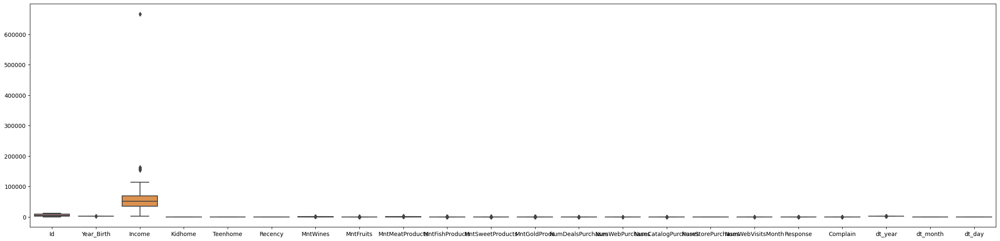

In [37]:
plt.figure(figsize=(30,7))
sns.boxplot(data=df)

### Removing columns which are known to be not affected by outliers from their value_counts


In [38]:

data = df.loc[:, ~df.columns.isin(['Id', 'Year_Birth','Response','Complain','dt_year','dt_month','dt_day'])]
data.head()

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth
0,Graduation,Divorced,84835.0,0,0,0,189,104,379,111,189,218,1,4,4,6,1
1,Graduation,Single,57091.0,0,0,0,464,5,64,7,0,37,1,7,3,7,5
2,Graduation,Married,67267.0,0,1,0,134,11,59,15,2,30,1,3,2,5,2
3,Graduation,Together,32474.0,1,1,0,10,0,1,0,0,0,1,1,0,2,7
4,Graduation,Single,21474.0,1,0,0,6,16,24,11,0,34,2,3,1,2,7


In [39]:
data=pd.get_dummies(data,columns=['Marital_Status', 'Education'])

### Scaling to identify outliers

In [40]:
num_cols

['Id',
 'Income',
 'Recency',
 'MntWines',
 'MntFruits',
 'MntMeatProducts',
 'MntFishProducts',
 'MntSweetProducts',
 'MntGoldProds',
 'NumDealsPurchases',
 'NumWebPurchases',
 'NumCatalogPurchases',
 'NumStorePurchases',
 'NumWebVisitsMonth']

In [41]:
from sklearn import preprocessing


for i in [
 'Income',
 'Recency',
 'MntWines',
 'MntFruits',
 'MntMeatProducts',
 'MntFishProducts',
 'MntSweetProducts',
 'MntGoldProds',
 'NumDealsPurchases',
 'NumWebPurchases',
 'NumCatalogPurchases',
 'NumStorePurchases',
 'NumWebVisitsMonth']:
    

    x = data[[i]].values.astype(float)
    min_max_scaler = preprocessing.MinMaxScaler()

    x_scaled = min_max_scaler.fit_transform(x)

    data[[i]] = pd.DataFrame(x_scaled)



In [42]:
data.head()

,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,...,Marital_Status_Married,Marital_Status_Single,Marital_Status_Together,Marital_Status_Widow,Marital_Status_YOLO,Education_2n Cycle,Education_Basic,Education_Graduation,Education_Master,Education_PhD
0,0.124982,0,0,0.0,0.126591,0.522613,0.219710,0.428571,0.718631,0.602210,...,0,0,0,0,0,0,0,1,0,0
1,0.083258,0,0,0.0,0.310784,0.025126,0.037101,0.027027,0.000000,0.102210,...,0,1,0,0,0,0,0,1,0,0
2,0.098561,0,1,0.0,0.089752,0.055276,0.034203,0.057915,0.007605,0.082873,...,1,0,0,0,0,0,0,1,0,0
3,0.046236,1,1,0.0,0.006698,0.000000,0.000580,0.000000,0.000000,0.000000,...,0,0,1,0,0,0,0,1,0,0
4,0.029693,1,0,0.0,0.004019,0.080402,0.013913,0.042471,0.000000,0.093923,...,0,1,0,0,0,0,0,1,0,0


In [43]:
data.columns

Index(['Income', 'Kidhome', 'Teenhome', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'Marital_Status_Absurd', 'Marital_Status_Alone',
       'Marital_Status_Divorced', 'Marital_Status_Married',
       'Marital_Status_Single', 'Marital_Status_Together',
       'Marital_Status_Widow', 'Marital_Status_YOLO', 'Education_2n Cycle',
       'Education_Basic', 'Education_Graduation', 'Education_Master',
       'Education_PhD'],
      dtype='object')

In [44]:
#considering numerical columns which are found suspicious from value_counts
data = data[['Income',
 'Kidhome',
 'Teenhome',
 'Recency',
 'MntWines',
 'MntFruits',
 'MntMeatProducts',
 'MntFishProducts',
 'MntSweetProducts',
 'MntGoldProds',
 'NumDealsPurchases',
 'NumWebPurchases',
 'NumCatalogPurchases',
 'NumStorePurchases',
 'NumWebVisitsMonth'
     ]]

# Box Plot to detect Outliers after scaling

<Axes: >

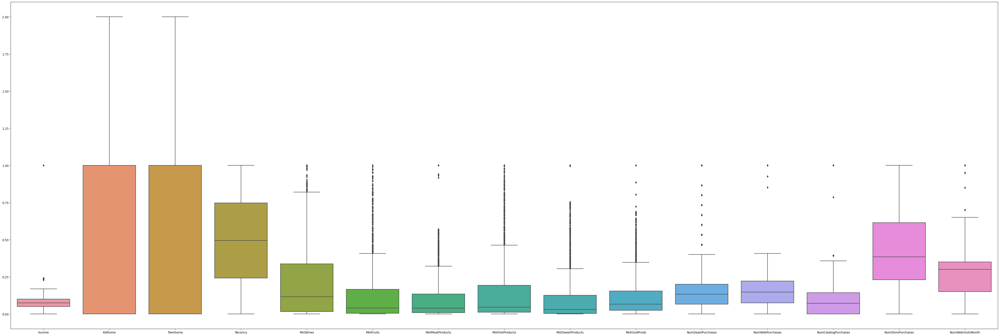

In [45]:
plt.figure(figsize=(60,20))
sns.boxplot(data=data) 

**MNTWines, MNTFruits,MNTMeatProducts, MNTFishProducts,MNTSweetProducts,MNTGoldProdcuts,NUMDealPurchases,NUMCatalogPurchases and NumWebVisitsMonth are consisting outliers**

# Identifying relationships

In [46]:
data.corr()


,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth
Income,1.000000,-0.428669,0.019133,-0.003970,0.578650,0.430842,0.584633,0.438871,0.440744,0.325916,-0.083101,0.387878,0.589162,0.529362,-0.553088
Kidhome,-0.428669,1.000000,-0.036133,0.008827,-0.496297,-0.372581,-0.437129,-0.387644,-0.370673,-0.349595,0.221798,-0.361647,-0.502237,-0.499683,0.447846
Teenhome,0.019133,-0.036133,1.000000,0.016198,0.004846,-0.176764,-0.261160,-0.204187,-0.162475,-0.021725,0.387741,0.155500,-0.110769,0.050695,0.134884
Recency,-0.003970,0.008827,0.016198,1.000000,0.016064,-0.004306,0.023056,0.001079,0.022670,0.016693,-0.001098,-0.010726,0.025110,0.000799,-0.021445
MntWines,0.578650,-0.496297,0.004846,0.016064,1.000000,0.389637,0.562667,0.399753,0.386581,0.387516,0.010940,0.542265,0.635226,0.642100,-0.320653
MntFruits,0.430842,-0.372581,-0.176764,-0.004306,0.389637,1.000000,0.543105,0.594804,0.567164,0.392995,-0.132114,0.296735,0.487917,0.461758,-0.418383
MntMeatProducts,0.584633,-0.437129,-0.261160,0.023056,0.562667,0.543105,1.000000,0.568402,0.523846,0.350609,-0.122415,0.293761,0.723827,0.479659,-0.539470
MntFishProducts,0.438871,-0.387644,-0.204187,0.001079,0.399753,0.594804,0.568402,1.000000,0.579870,0.422875,-0.139361,0.293681,0.534478,0.459855,-0.446003
MntSweetProducts,0.440744,-0.370673,-0.162475,0.022670,0.386581,0.567164,0.523846,0.579870,1.000000,0.369724,-0.120100,0.348544,0.490924,0.448756,-0.423294
MntGoldProds,0.325916,-0.349595,-0.021725,0.016693,0.387516,0.392995,0.350609,0.422875,0.369724,1.000000,0.049085,0.421836,0.437697,0.381678,-0.250719


`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations


<Axes: >

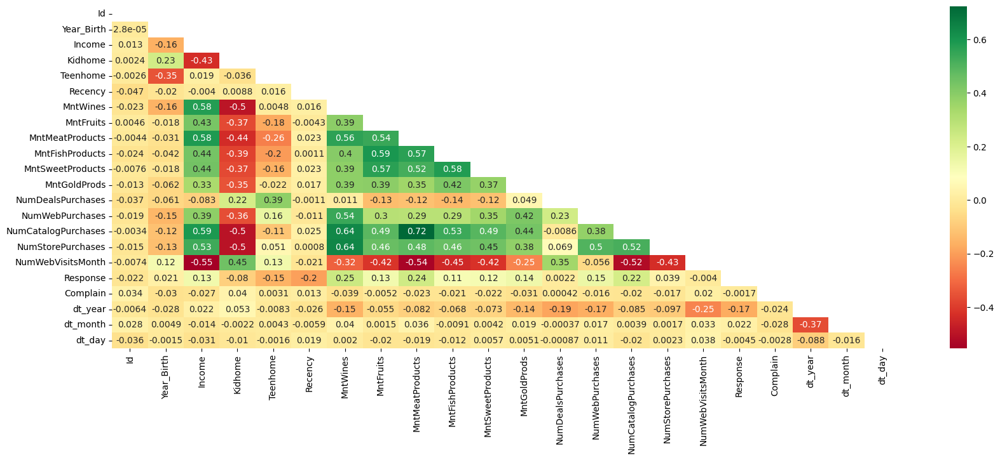

In [47]:
plt.figure(figsize=(20,7))

mask = np.triu(np.ones_like(df.corr(), dtype=np.bool))

sns.heatmap(df.corr(), mask=mask, annot=True, cmap='RdYlGn')

**None of the independent variables have very strongly correlated to each other in a way that they represent exact same data**

## But we can see NumCatalogPurchases is correlated to Amount earned from different products(meat, wines, fish and gold).

## And Amount generated from products(meat, wines, fish and gold) is correlated with income

## Income is also correlated with number of store and catalog purchases


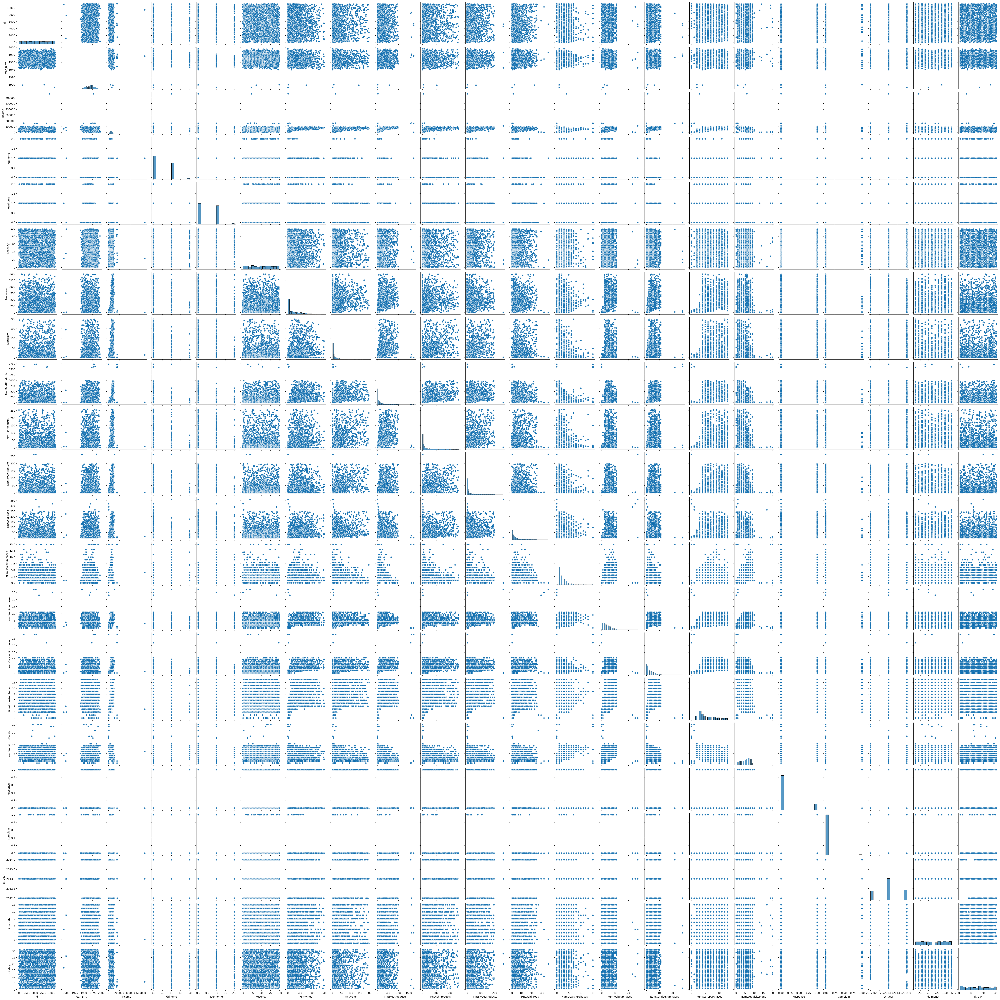

In [48]:
sns.pairplot(df) 


# Identifing predictor significance


In [49]:
data= df[:]

# Fill Income mising with mean instead of dropping data

In [50]:
data['Income']=data['Income'].fillna(data['Income'].mean())

In [51]:
# Outliers can be removed as follows with understanding data

# Removing 'Year_Birth' outliers 

indices=data[data['Year_Birth']<1930].index
data.drop(indices,inplace=True)
#Removing ouliers in income>4000000
ind=data[data['Income']>400000].index
df=data.drop(ind)

In [52]:
pd.crosstab(df['Marital_Status'],df['Response'],values=df['Income'],aggfunc='mean').round(2)


Response,0,1
Marital_Status,,
Absurd,65487.00,79244.00
Alone,47753.50,35860.00
Divorced,50601.85,61682.56
Married,50641.10,60234.26
Single,48288.91,60538.58
Together,51417.85,58179.67
Widow,54791.41,61418.07
YOLO,48432.00,48432.00


In [53]:
Edu=pd.get_dummies(df['Education'],drop_first=True)
Edu.head()

,Basic,Graduation,Master,PhD
0,0,1,0,0
1,0,1,0,0
2,0,1,0,0
3,0,1,0,0
4,0,1,0,0


In [54]:
Marital=pd.get_dummies(df['Marital_Status'],drop_first=True)
Marital.head()

,Alone,Divorced,Married,Single,Together,Widow,YOLO
0,0,1,0,0,0,0,0
1,0,0,0,1,0,0,0
2,0,0,1,0,0,0,0
3,0,0,0,0,1,0,0
4,0,0,0,1,0,0,0


In [55]:
#Group the different marital status dummies to reduce dimensionality.

Married=Marital.iloc[:,2]
Together=Marital.iloc[:,4]
Single=Marital.iloc[:,3]
Divorced=Marital.iloc[:,1]
Other=Marital.loc[:,['Widow','Alone','YOLO']].max(axis=1)

In [56]:
data.columns

Index(['Id', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts',
       'MntFishProducts', 'MntSweetProducts', 'MntGoldProds',
       'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',
       'NumStorePurchases', 'NumWebVisitsMonth', 'Response', 'Complain',
       'dt_year', 'dt_month', 'dt_day'],
      dtype='object')

### Drop Education and Marital_Status to avoid redundancy when we concat the Dummies with dataframe


In [57]:
df=pd.concat([df,Edu,Married,Together,Single,Divorced,Other],axis=1)
#Drop columns not needed
df=df.drop(['Year_Birth','Education','Marital_Status',],axis=1)
df.head()

,Id,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,...,dt_day,Basic,Graduation,Master,PhD,Married,Together,Single,Divorced,0
0,1826,84835.0,0,0,0,189,104,379,111,189,...,16,0,1,0,0,0,0,0,1,0
1,1,57091.0,0,0,0,464,5,64,7,0,...,15,0,1,0,0,0,0,1,0,0
2,10476,67267.0,0,1,0,134,11,59,15,2,...,13,0,1,0,0,1,0,0,0,0
3,1386,32474.0,1,1,0,10,0,1,0,0,...,5,0,1,0,0,0,1,0,0,0
4,5371,21474.0,1,0,0,6,16,24,11,0,...,4,0,1,0,0,0,0,1,0,0


In [58]:
df=df.drop('Id',axis=1)

In [59]:
df.columns


Index([             'Income',             'Kidhome',            'Teenhome',
                   'Recency',            'MntWines',           'MntFruits',
           'MntMeatProducts',     'MntFishProducts',    'MntSweetProducts',
              'MntGoldProds',   'NumDealsPurchases',     'NumWebPurchases',
       'NumCatalogPurchases',   'NumStorePurchases',   'NumWebVisitsMonth',
                  'Response',            'Complain',             'dt_year',
                  'dt_month',              'dt_day',               'Basic',
                'Graduation',              'Master',                 'PhD',
                   'Married',            'Together',              'Single',
                  'Divorced',                     0],
      dtype='object')

In [60]:
#Remane '0' column to 'Other'
cols=['Income','Kidhome',  'Teenhome','Recency','MntWines','MntFruits',
           'MntMeatProducts','MntFishProducts','MntSweetProducts',
              'MntGoldProds','NumDealsPurchases','NumWebPurchases',
       'NumCatalogPurchases','NumStorePurchases','NumWebVisitsMonth',
                  'Response','Complain','dt_year','dt_month','dt_day','Basic',
                'Graduation','Master','PhD',
                   'Married','Together','Single',
                  'Divorced','Other']

In [61]:
df.columns=cols
orderd_cols=['Income','Basic','Graduation','Master','PhD','Married','Together','Single',
                  'Divorced','Other','Kidhome','Teenhome','Recency','Complain','MntWines','MntFruits','dt_year','dt_month','dt_day',
           'MntMeatProducts','MntFishProducts','MntSweetProducts',
              'MntGoldProds','NumDealsPurchases','NumWebPurchases',
       'NumCatalogPurchases','NumStorePurchases','NumWebVisitsMonth','Response']
df=df[orderd_cols]
df.head()

,Income,Basic,Graduation,Master,PhD,Married,Together,Single,Divorced,Other,...,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Response
0,84835.0,0,1,0,0,0,0,0,1,0,...,379,111,189,218,1,4,4,6,1,1
1,57091.0,0,1,0,0,0,0,1,0,0,...,64,7,0,37,1,7,3,7,5,1
2,67267.0,0,1,0,0,1,0,0,0,0,...,59,15,2,30,1,3,2,5,2,0
3,32474.0,0,1,0,0,0,1,0,0,0,...,1,0,0,0,1,1,0,2,7,0
4,21474.0,0,1,0,0,0,0,1,0,0,...,24,11,0,34,2,3,1,2,7,1


In [62]:
df1=df.copy()


In [63]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()

# scaling the data to avoid influence of data with large ranges on other variables

In [64]:
cols_to_scale=['Income','Kidhome', 'Teenhome', 'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts',
       'MntFishProducts', 'MntSweetProducts', 'MntGoldProds','dt_year','dt_month','dt_day',
       'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',
       'NumStorePurchases', 'NumWebVisitsMonth']

In [65]:
df1[cols_to_scale]=scaler.fit_transform(df1[cols_to_scale])


In [66]:
import statsmodels.api as sm
model = sm.OLS(df1['Response'], df1[cols_to_scale]).fit()
# Print out the statistics
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:               Response   R-squared (uncentered):                   0.167
Model:                            OLS   Adj. R-squared (uncentered):              0.160
Method:                 Least Squares   F-statistic:                              24.68
Date:                Sun, 09 Apr 2023   Prob (F-statistic):                    4.42e-75
Time:                        23:34:40   Log-Likelihood:                         -843.01
No. Observations:                2236   AIC:                                      1722.
Df Residuals:                    2218   BIC:                                      1825.
Df Model:                          18                                                  
Covariance Type:            nonrobust                                                  
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
Income                  0.0266      0.015      1.752      0.080      -0.003       0.056
Kidhome                 0.0100      0.010      0.982      0.326      -0.010       0.030
Teenhome               -0.0465      0.009     -5.039      0.000      -0.065      -0.028
Recency                -0.0740      0.008     -9.850      0.000      -0.089      -0.059
MntWines                0.0803      0.013      6.360      0.000       0.056       0.105
MntFruits               0.0066      0.010      0.635      0.525      -0.014       0.027
MntMeatProducts         0.0459      0.013      3.533      0.000       0.020       0.071
MntFishProducts        -0.0184      0.011     -1.701      0.089      -0.040       0.003
MntSweetProducts        0.0013      0.010      0.123      0.902      -0.019       0.022
MntGoldProds            0.0166      0.009      1.816      0.069      -0.001       0.035
dt_year                -0.0478      0.009     -5.311      0.000      -0.065      -0.030
dt_month               -0.0166      0.008     -2.038      0.042      -0.033      -0.001
dt_day                 -0.0040      0.008     -0.533      0.594      -0.019       0.011
NumDealsPurchases       0.0043      0.010      0.440      0.660      -0.015       0.023
NumWebPurchases         0.0148      0.010      1.408      0.159      -0.006       0.035
NumCatalogPurchases     0.0265      0.013      2.041      0.041       0.001       0.052
NumStorePurchases      -0.0831      0.011     -7.236      0.000      -0.106      -0.061
NumWebVisitsMonth       0.0318      0.012      2.545      0.011       0.007       0.056
==============================================================================
Omnibus:                      491.015   Durbin-Watson:                   1.595
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              886.645
Skew:                           1.387   Prob(JB):                    2.93e-193
Kurtosis:                       4.350   Cond. No.                         6.08
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

# Significant predictors based on p-value from OLS:
    
**LOWER THE P-VALUE HIGHER THE SIGNIFICANCE**
    
1. dt_year, 
2. NumStorePurchases, 
3. MntMeatProducts, 
4. MntWines, 
5. Recency, 
6. Teenhome, 
7. NumCatalogPurchases, 
8. dt_month, 
9. NumWebVisitsMonth, 
10. MntGoldProds,
11. Income, 
12. MntFruits

# Understanding tests

***Skew and Kurtosis***

Skewness tells us the amount and direction of skew(Departure from the central axis) and Kurtosis tells us how tall and sharp the central peak is. The optimum value for these two measures is 0, in our case we have a value for Skew and Kurtosis as -0.4, 4.4 respectively.

***Durbin-Watson***

The Durbin-Watson test is a statistical test to detect auto-correlation in the residuals of a regression analysis. Its range is 0 to 4.

Value of 2 indicates that no auto correlation is detected
Value between 0 to 2 indicates that there is positive auto correlation detected
Value between 2 to 4 indicates that there is negatibe auto correlation detected
Our model has a DW score of 1.6 which could be interpreted as a positive auto-correlation in the residuals of regression.

***Jarque-Bera Test***

The JB test is known as the test of Normality, irrespective if the data has skew or kurtosis. If it is far from zero, it signals the data do not have a normal distribution. Our JB value is 289.5 which again re-inforces the interpretation we got from Skew and Kurtosis.

Training classifier

In [67]:
from sklearn.model_selection import  train_test_split

X = df1.loc[:,~df1.columns.isin(['Response'])]

y = df['Response']

#Spliting data into Training, Validation set and Test set 

X_t, X_test, y_t, y_test = train_test_split(X, y, test_size=0.1, random_state=1)

X_train, X_val, y_train, y_val = train_test_split(X_t, y_t, test_size=0.15, random_state=1)

In [68]:
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)
logreg = LogisticRegression(solver='lbfgs',max_iter=1000)
logreg.fit(X_train, y_train)

LogisticRegression(max_iter=1000)

# Identify whether the training and test sets have the same data

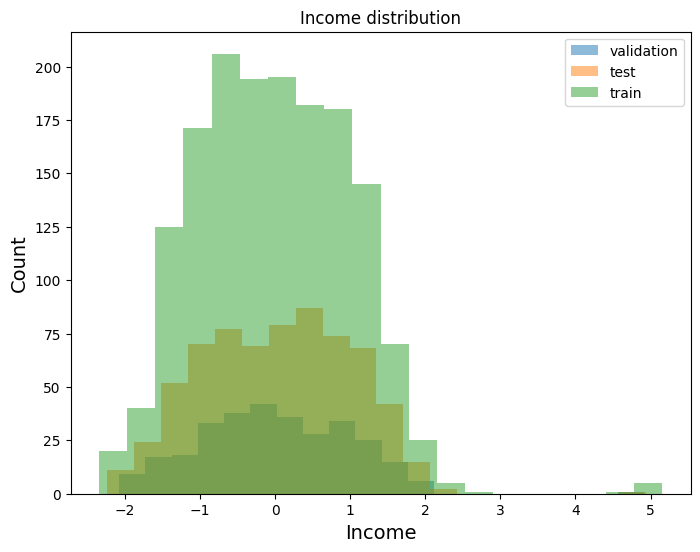

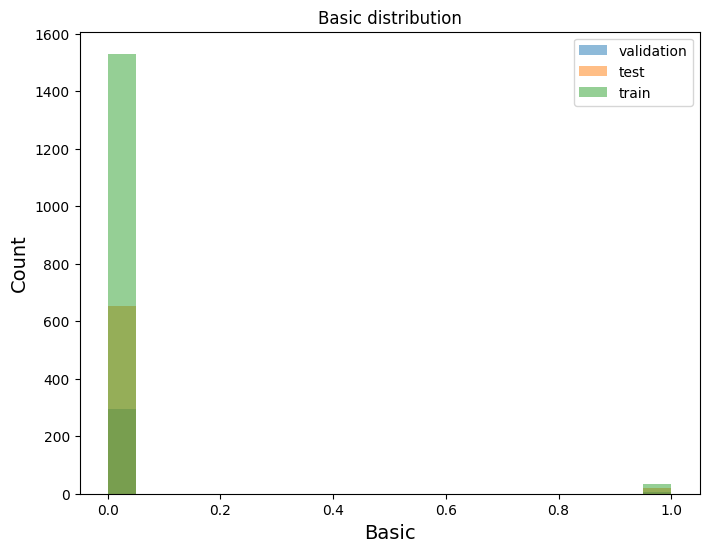

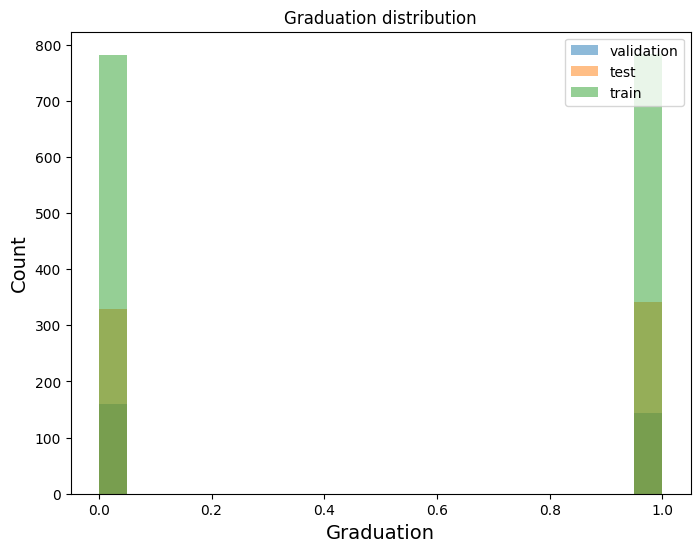

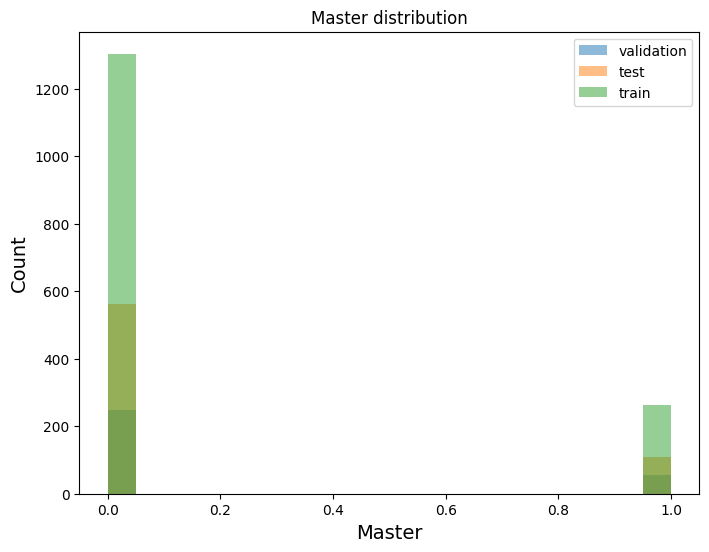

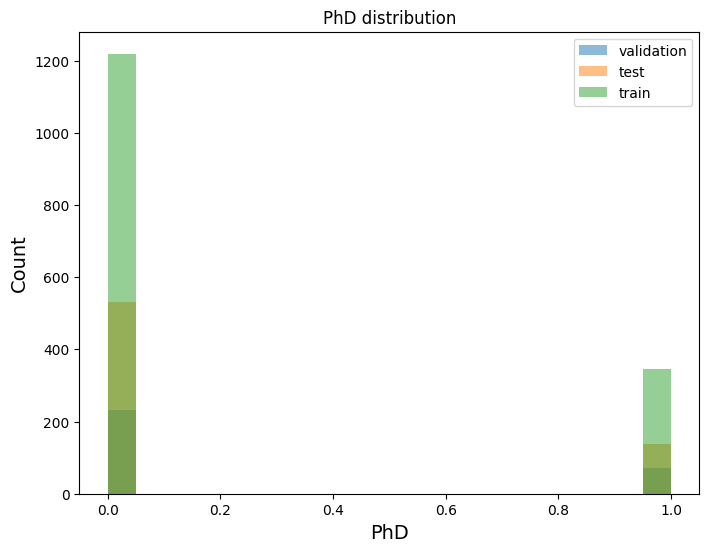

...

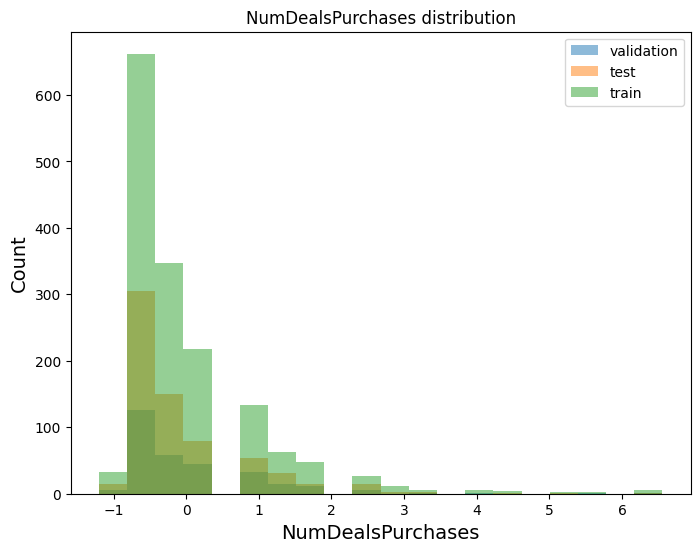

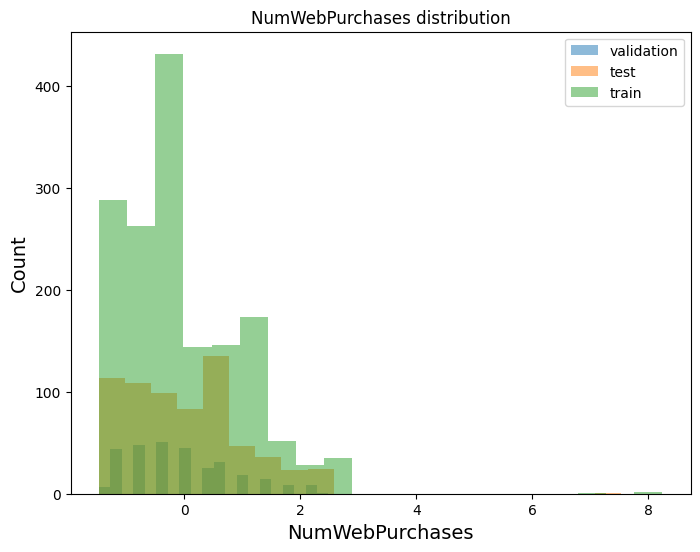

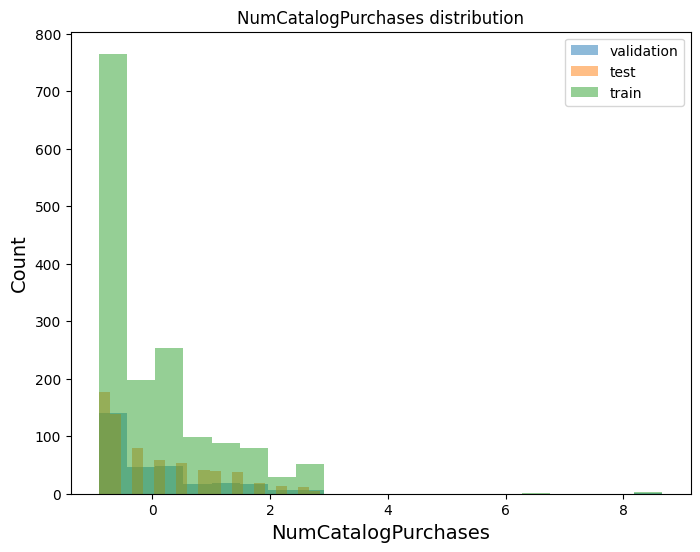

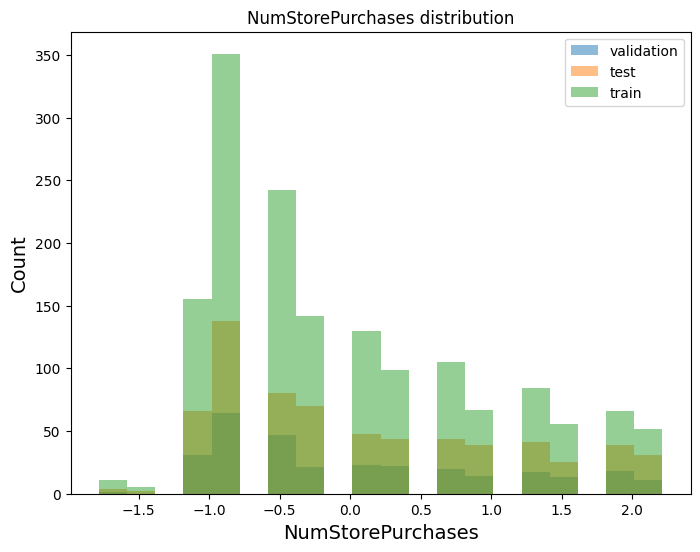

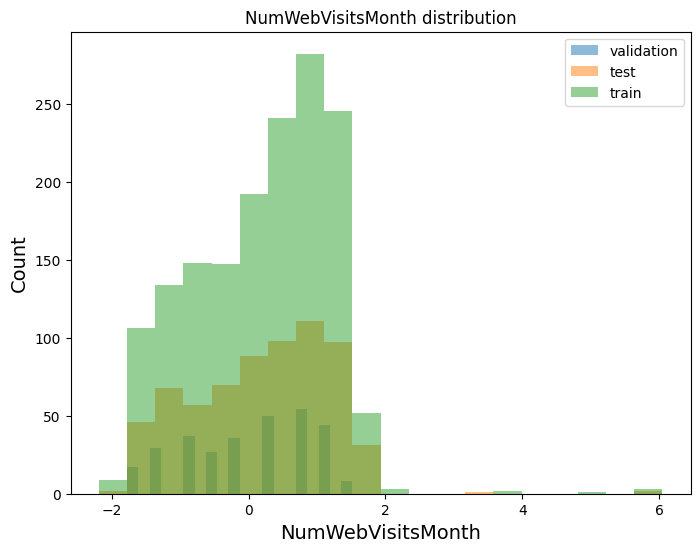

In [69]:
X_test_plot = X_test[list(X_test.columns)]

X_val_plot = X_val[list(X_val.columns)]

X_train_plot = X_train[list(X_train.columns)]

# Plotting the data to see the histogram
for c in X_test_plot.columns[:]:
  plt.figure(figsize=(8,6))
  plt.hist(X_val_plot[c], bins=20, alpha=0.5, label="validation")
  plt.hist(X_test_plot[c], bins=20, alpha=0.5, label="test")
  plt.hist(X_train_plot[c], bins=20, alpha=0.5, label="train")
  plt.xlabel(c, size=14)
  plt.ylabel("Count", size=14)
  plt.legend(loc='upper right')
  plt.title("{} distribution".format(c))
  plt.show()

## Due to few outliers in Income, MntWines, Num DealPurchases, Num Store Purchases, Few edge values are missing in validation and test sets 


### Some nominal values which are available low in Education and martial status are missing in test and validation sets

# Training Decision Tree Classifier

In [70]:
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics
cl_tree=DecisionTreeClassifier(criterion='entropy',max_depth=10)
cl_tree=cl_tree.fit(X_train,y_train)

In [71]:
cl_tree.feature_importances_

array([0.05953938, 0.01324178, 0.        , 0.00542805, 0.01674646,
       0.        , 0.0170763 , 0.00487118, 0.01080569, 0.00903986,
       0.00643874, 0.02017755, 0.12251204, 0.        , 0.11379985,
       0.02852883, 0.03935866, 0.02726272, 0.04448668, 0.10068749,
       0.0417521 , 0.01976607, 0.06504351, 0.03112906, 0.01873128,
       0.08091776, 0.04204326, 0.06061569])

In [72]:
feat_dict= {}
for col, val in sorted(zip(X_train.columns, cl_tree.feature_importances_),key=lambda x:x[1],reverse=True):
  feat_dict[col]=val

In [73]:
feat_df = pd.DataFrame({'Feature':feat_dict.keys(),'Importance':feat_dict.values()})

l = list(zip(feat_dict.values(), feat_dict.keys()))

## Significant predictors based on feature importances from Decision tree

1. 'Recency'
2. 'MntMeatProducts',
3. 'MntWines',
4. 'NumCatalogPurchases', 
5. 'NumWebVisitsMonth', 
6. 'Income',
7. 'dt_day', 
8. 'MntGoldProds', 
9. 'dt_year', 
10. 'NumStorePurchases', 
11. 'NumDealsPurchases', 
12. 'MntFishProducts', 
13. 'NumWebPurchases'
14. 'Education'


In [74]:
feat_df


,Feature,Importance
0,Recency,0.122512
1,MntWines,0.113800
2,MntMeatProducts,0.100687
3,NumCatalogPurchases,0.080918
4,MntGoldProds,0.065044
5,NumWebVisitsMonth,0.060616
6,Income,0.059539
7,dt_day,0.044487
8,NumStorePurchases,0.042043
9,MntFishProducts,0.041752


# Accuracy

In [75]:
pred=cl_tree.predict(X_test)
Accuracy=round(metrics.accuracy_score(y_test,pred)*100,2)
print("The accuracy of the decision tree classiffier is:"+str(Accuracy)+ "%")

The accuracy of the decision tree classiffier is:83.46%


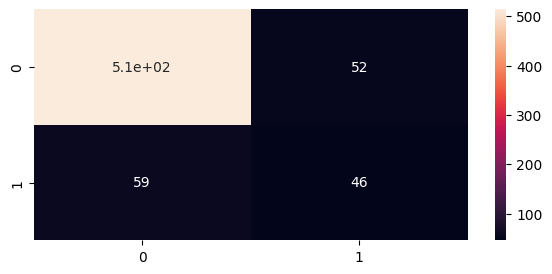

In [76]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
cm=confusion_matrix(y_test,pred)
%matplotlib inline
plt.figure(figsize=(7,3))
sns.heatmap(cm,annot=True)
plt.show()

# Classification report

In [77]:
print(classification_report(y_test,pred))

              precision    recall  f1-score   support

           0       0.90      0.91      0.90       566
           1       0.47      0.44      0.45       105

    accuracy                           0.83       671
   macro avg       0.68      0.67      0.68       671
weighted avg       0.83      0.83      0.83       671



In [78]:
# Visualising nodes of tree

In [79]:
from sklearn.tree import export_graphviz
import pydot
import matplotlib.image as mpimg
cl_tree=DecisionTreeClassifier(criterion='entropy',max_depth=3)
cl_tree=cl_tree.fit(X_train,y_train)

export_graphviz(
    cl_tree,
    out_file="tree.dot",
    feature_names=list(X_train.columns),
    rounded=True,
    precision=1,
)
(graph,) = pydot.graph_from_dot_file("tree.dot")
graph.write_png("tree.png")
img = mpimg.imread("tree.png")

plt.figure(figsize = (600,80))
imgplot = plt.imshow(img)

plt.show()
     

In [80]:
from sklearn import tree

print(tree.export_text(cl_tree))

|--- feature_14 <= 1.14
|   |--- feature_12 <= -1.02
|   |   |--- feature_27 <= 0.90
|   |   |   |--- class: 0
|   |   |--- feature_27 >  0.90
|   |   |   |--- class: 1
|   |--- feature_12 >  -1.02
|   |   |--- feature_16 <= -0.77
|   |   |   |--- class: 0
|   |   |--- feature_16 >  -0.77
|   |   |   |--- class: 0
|--- feature_14 >  1.14
|   |--- feature_19 <= 2.45
|   |   |--- feature_26 <= 1.14
|   |   |   |--- class: 0
|   |   |--- feature_26 >  1.14
|   |   |   |--- class: 0
|   |--- feature_19 >  2.45
|   |   |--- feature_18 <= 1.35
|   |   |   |--- class: 1
|   |   |--- feature_18 >  1.35
|   |   |   |--- class: 0



# Examining nodes of tree:

Feature 0 is selected first. If Income < 1.18 then next selected feature is used to split the data. Next NumberOfVisits with greater or less than -0.26 is used to split data. It continues till max deppth is reached or no further features available to select.

Gini index is used as impurity measure.

if value=[1,2], the current node received 1 samples from class 0 & 2 from class 1.


**Importance_Nodeₖ =
(%_of_sample_reaching_Nodeₖ X Impurity_Nodeₖ -
%_of_sample_reaching_left_subtree_NodeₖX Impurity_left_subtree_Nodeₖ-
%_of_sample_reaching_right_subtree_NodeₖX Impurity_right_subtree_Nodeₖ) / 100**

feature importance for feature 

K=

**Σnode’s importance splitting on feature K / Σ all node’s importance**

That means the numerator is a summation of node importances of all nodes that split on a particular feature K upon summation of all node importances

***A root node:*** this is the node that begins the splitting process by finding the variable that best splits the target variable

***Node purity:*** Decision nodes are impure, as they have mixture of both classes of the target variable. Pure nodes are those that have one class.

***Decision nodes:*** these are intermediate nodes, where the target variable is again split further by other variables

***Entropy:***

entropy is a measure of disorder or impurity in a node. Thus, a node with more variable composition, such as 2 yes and 2 no would be considered to have higher Entropy than a node which has only yes or only no. The maximum level of entropy or disorder is given by 1 and minimum entropy is given by a value 0.

***Information Gain***:

E(entorpy) - Avg(E(children))

# Logistic Regression Classifier

In [81]:
from sklearn.linear_model import LogisticRegression
logi=LogisticRegression()
logi.fit(X_train,y_train)
predi=logi.predict(X_test)
#logistic_accuracy=round(logi.score(x_train,y_train)*100,2)
acc_scor=round(accuracy_score(y_test,predi)*100,2)
#print(acc_scor)
print(" The Accuracy of the logistic classification is:"+str(acc_scor)+"%")

 The Accuracy of the logistic classification is:86.89%


# Classification report

In [82]:
print(classification_report(y_test,predi))


              precision    recall  f1-score   support

           0       0.88      0.98      0.93       566
           1       0.74      0.25      0.37       105

    accuracy                           0.87       671
   macro avg       0.81      0.62      0.65       671
weighted avg       0.85      0.87      0.84       671



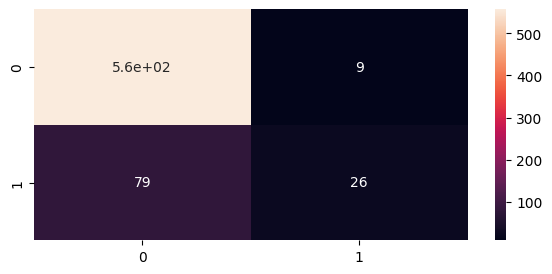

In [83]:
cmi=confusion_matrix(y_test,predi)
%matplotlib inline
plt.figure(figsize=(7,3))
sns.heatmap(cmi,annot=True)
plt.show()

In [84]:
logi.coef_[0]

array([ 0.18371182, -0.83997883,  0.17768585,  0.3265902 ,  0.76597484,
       -0.54496564, -0.65698756,  0.27237571,  0.43833829,  0.57285851,
        0.19063371, -0.55263742, -0.73016221,  0.00160504,  0.51787353,
        0.01634544, -0.55766185, -0.15005288, -0.02502454,  0.36840279,
       -0.12663702,  0.05213851,  0.20946068,  0.02122551,  0.11906333,
        0.15680032, -0.57931847,  0.30448759])

In [85]:
feat_dict= {}
for col, val in sorted(zip(X_train.columns, logi.coef_[0]),key=lambda x:x[1],reverse=True):
  feat_dict[col]=val

In [86]:
feat_df = pd.DataFrame({'Feature':feat_dict.keys(),'Coeff':feat_dict.values()})
feat_df


,Feature,Coeff
0,PhD,0.765975
1,Other,0.572859
2,MntWines,0.517874
3,Divorced,0.438338
4,MntMeatProducts,0.368403
5,Master,0.326590
6,NumWebVisitsMonth,0.304488
7,Single,0.272376
8,MntGoldProds,0.209461
9,Kidhome,0.190634


<BarContainer object of 28 artists>

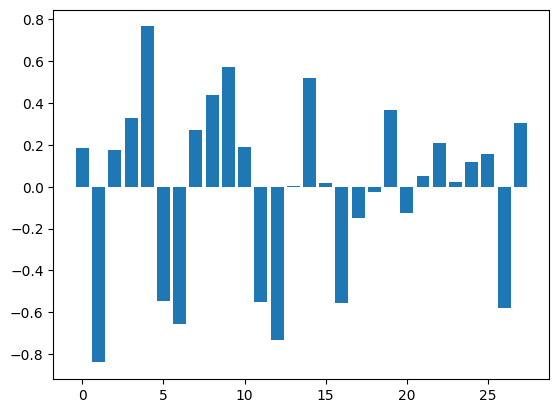

In [87]:
from matplotlib import pyplot

importance = logi.coef_[0]

pyplot.bar([x for x in range(len(importance))], importance)


In [88]:
feat_imp=[]
for i,v in enumerate(logi.coef_[0]):
    print('Feature: {}, Score: {}'.format(X_train.columns[i],v))
    feat_imp.append((abs(v),X_train.columns[i]))

Feature: Income, Score: 0.18371181582327362
Feature: Basic, Score: -0.8399788346375039
Feature: Graduation, Score: 0.17768585065961864
Feature: Master, Score: 0.3265901954920716
Feature: PhD, Score: 0.7659748409974266
Feature: Married, Score: -0.544965638906787
Feature: Together, Score: -0.6569875626012797
Feature: Single, Score: 0.2723757133025348
Feature: Divorced, Score: 0.43833829311981165
Feature: Other, Score: 0.5728585052870997
Feature: Kidhome, Score: 0.19063371484207245
Feature: Teenhome, Score: -0.5526374232771308
Feature: Recency, Score: -0.7301622074072803
Feature: Complain, Score: 0.0016050355769066356
Feature: MntWines, Score: 0.5178735318710362
Feature: MntFruits, Score: 0.016345436644369476
Feature: dt_year, Score: -0.5576618497551111
Feature: dt_month, Score: -0.15005287978859283
Feature: dt_day, Score: -0.025024536215526735
Feature: MntMeatProducts, Score: 0.3684027858987309
Feature: MntFishProducts, Score: -0.12663701530092575
Feature: MntSweetProducts, Score: 0.0521

In [89]:
feat_imp.sort()
feat_imp

[(0.0016050355769066356, 'Complain'),
 (0.016345436644369476, 'MntFruits'),
 (0.021225514296925995, 'NumDealsPurchases'),
 (0.025024536215526735, 'dt_day'),
 (0.05213851023176969, 'MntSweetProducts'),
 (0.11906332569069941, 'NumWebPurchases'),
 (0.12663701530092575, 'MntFishProducts'),
 (0.15005287978859283, 'dt_month'),
 (0.15680031526357455, 'NumCatalogPurchases'),
 (0.17768585065961864, 'Graduation'),
 (0.18371181582327362, 'Income'),
 (0.19063371484207245, 'Kidhome'),
 (0.20946067807491126, 'MntGoldProds'),
 (0.2723757133025348, 'Single'),
 (0.3044875936201844, 'NumWebVisitsMonth'),
 (0.3265901954920716, 'Master'),
 (0.3684027858987309, 'MntMeatProducts'),
 (0.43833829311981165, 'Divorced'),
 (0.5178735318710362, 'MntWines'),
 (0.544965638906787, 'Married'),
 (0.5526374232771308, 'Teenhome'),
 (0.5576618497551111, 'dt_year'),
 (0.5728585052870997, 'Other'),
 (0.5793184686443983, 'NumStorePurchases'),
 (0.6569875626012797, 'Together'),
 (0.7301622074072803, 'Recency'),
 (0.765974840

## Significant predictors based on regression coefficients

1. 'Recency', 
2. 'Education', 
3. 'NumStorePurchases'
4. 'dt_year'
5. 'Teenhome'
6. 'Martial Status'
7. 'MntMeatProducts' 
8. 'NumWebVisitsMonth' 
9. 'MntGoldProds'
10. 'MntWines'
11. 'Kidhome'
12. 'Income'
13. 'NumCatalogPurchases'
14. 'NumWebPurchases'




# Permutation Importance on logistic regression

In [90]:
from sklearn.inspection import permutation_importance
r = permutation_importance(logi, X_train, y_train,
                           n_repeats=30,
                           random_state=0)



In [91]:
print(X_train.columns)

Index(['Income', 'Basic', 'Graduation', 'Master', 'PhD', 'Married', 'Together',
       'Single', 'Divorced', 'Other', 'Kidhome', 'Teenhome', 'Recency',
       'Complain', 'MntWines', 'MntFruits', 'dt_year', 'dt_month', 'dt_day',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth'],
      dtype='object')


Feature: Income, Score: 0.0015548455804046475
Feature: Basic, Score: 0.00017039403620870233
Feature: Graduation, Score: 0.001384451544195912
Feature: Master, Score: -0.0009158679446219546
Feature: PhD, Score: -0.00074547390841323
Feature: Married, Score: 0.004536741214057472
Feature: Together, Score: 0.0007454739084131708
Feature: Single, Score: 0.0014270500532481023
Feature: Divorced, Score: 0.0018317358892438352
Feature: Other, Score: 0.0008093716719914434
Feature: Kidhome, Score: 0.0024494142705004827
Feature: Teenhome, Score: 0.01124600638977632
Feature: Recency, Score: 0.011970181043663437
Feature: Complain, Score: 0.0
Feature: MntWines, Score: 0.009073482428114983
Feature: MntFruits, Score: -0.0005750798722045018
Feature: dt_year, Score: 0.003727369542065995
Feature: dt_month, Score: 0.002406815761448311
Feature: dt_day, Score: -0.0006602768903088788
Feature: MntMeatProducts, Score: 0.006198083067092615
Feature: MntFishProducts, Score: 0.0020447284345047573
Feature: MntSweetProdu

<BarContainer object of 28 artists>

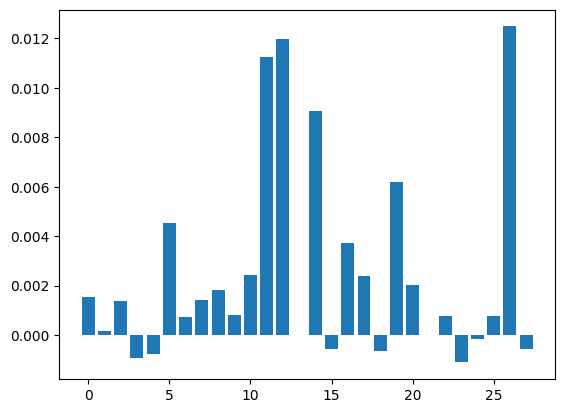

In [92]:
importance = r.importances_mean
# summarize feature importance
feat_imp=[]
for i,v in enumerate(importance):
    print('Feature: {}, Score: {}'.format(X_train.columns[i],v))
    feat_imp.append((abs(v),X_train.columns[i]))

# plot feature importance
pyplot.bar([x for x in range(len(importance))], importance)

In [93]:
feat_imp.sort()
feat_imp

[(0.0, 'Complain'),
 (2.960594732333751e-17, 'MntSweetProducts'),
 (0.0001490947816826645, 'NumWebPurchases'),
 (0.00017039403620870233, 'Basic'),
 (0.0005537806176784048, 'NumWebVisitsMonth'),
 (0.0005750798722045018, 'MntFruits'),
 (0.0006602768903088788, 'dt_day'),
 (0.0007454739084131708, 'Together'),
 (0.00074547390841323, 'PhD'),
 (0.0007880724174653537, 'NumCatalogPurchases'),
 (0.0007880724174653612, 'MntGoldProds'),
 (0.0008093716719914434, 'Other'),
 (0.0009158679446219546, 'Master'),
 (0.0011075612353567761, 'NumDealsPurchases'),
 (0.001384451544195912, 'Graduation'),
 (0.0014270500532481023, 'Single'),
 (0.0015548455804046475, 'Income'),
 (0.0018317358892438352, 'Divorced'),
 (0.0020447284345047573, 'MntFishProducts'),
 (0.002406815761448311, 'dt_month'),
 (0.0024494142705004827, 'Kidhome'),
 (0.003727369542065995, 'dt_year'),
 (0.004536741214057472, 'Married'),
 (0.006198083067092615, 'MntMeatProducts'),
 (0.009073482428114983, 'MntWines'),
 (0.01124600638977632, 'Teenhome

## Significant predictors based on Permutation importance mean

1. 'NumStorePurchases'
2. 'Recency'
3. 'Teenhome'
4. 'MntWines'
5. 'Education'
6. 'MntMeatProducts'
7. 'Kidhome'
8. 'dt_year'
9. 'MntFishProducts'
10. 'Income'
11. 'NumDealsPurchases', 
12. 'MntGoldProds' 
13. 'Kidhome', 
14. 'NumCatalogPurchases', 




## The following features are identified important from different methods:
    
1. 'Income',
2. 'MntGoldProds',
3. 'MntMeatProducts',
4. 'MntWines',
5. 'NumCatalogPurchases',
6. 'NumStorePurchases',
7. 'NumWebPurchases',
8. 'Recency',
9. 'dt_year'
    

In [94]:
# Interpretation of Linear and tree based models


# Interpretation of Linear model


In [95]:
explainer = shap.LinearExplainer(logreg, masker=shap.maskers.Impute(data=X_train),
                           feature_names=X_train.columns, algorithm="linear")

Estimating transforms:   0%|          | 0/1000 [00:00<?, ?it/s]

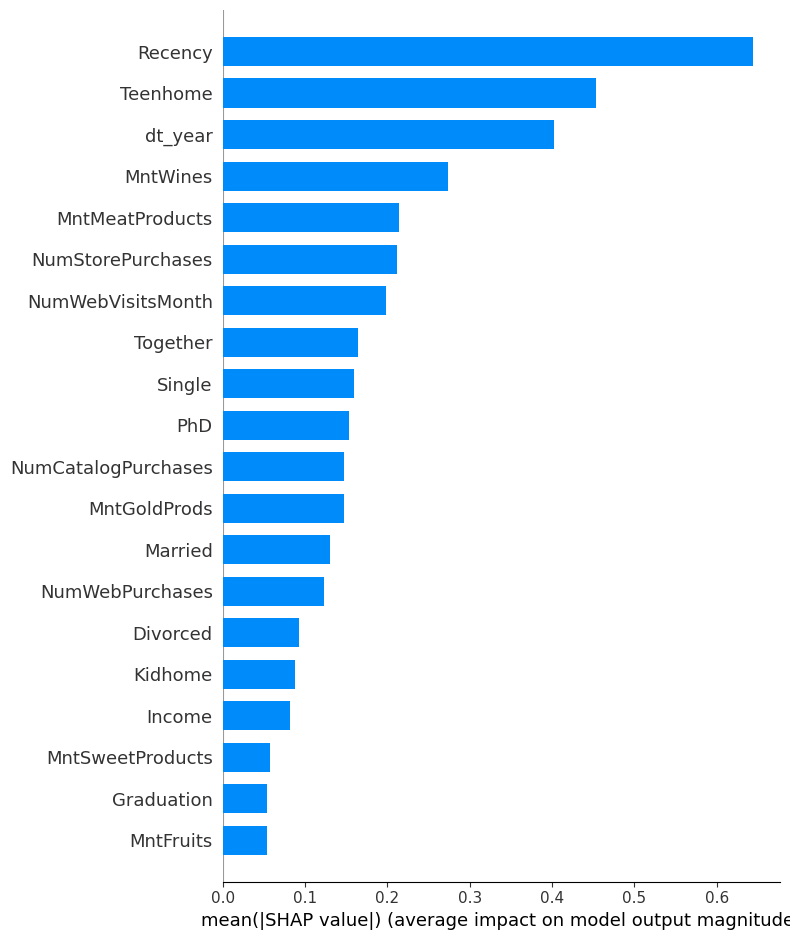

In [96]:
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test, plot_type='bar')

## The above plot shows the importance of each feature based on mean(|shap|) similar to tree based feature importance plot

In [97]:
#Linear 

explainer = shap.LinearExplainer(logreg, masker=shap.maskers.Impute(data=X_train),
                           feature_names=X_train.columns, algorithm="linear")
shap_values = explainer(X_test)

Estimating transforms:   0%|          | 0/1000 [00:00<?, ?it/s]

# waterfall plot

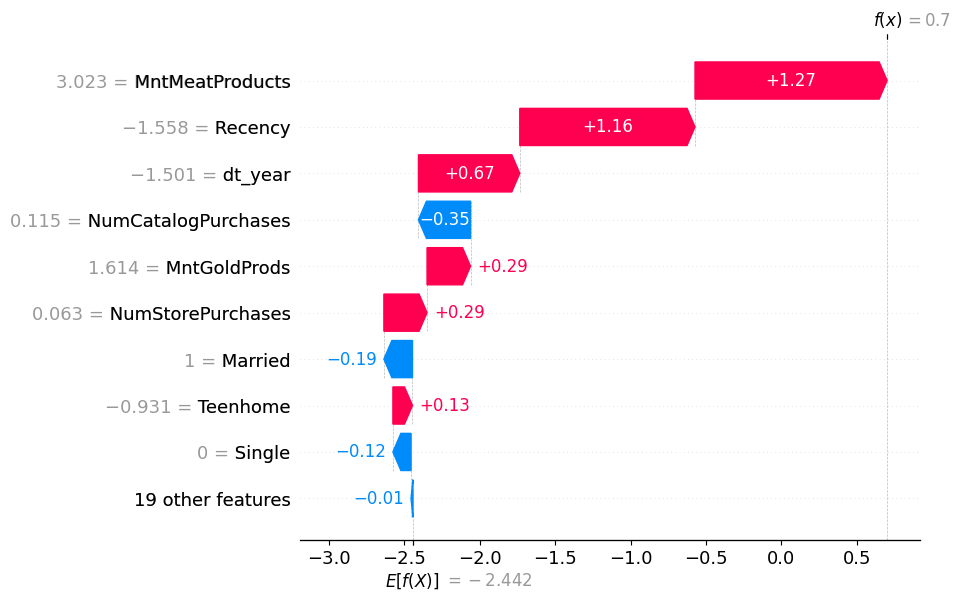

In [98]:
shap.plots.waterfall(shap_values[0])


***The waterfall plot is designed to visually display how the SHAP values (evidence) of each feature move the model output from our prior expectation under the background data distribution, to the final model prediction given the evidence of all the features***

Expected value or avaerge outcome value is -2.457 and current observation actual value is -3.874

### the waterfall_plot shows how we get from explainer.expected_value to model.predict(X)[sample_ind]

1. dt_year dcreased 0.79 units from average predicted value to get the actual 

2. Num catalog purchases was increased by 0.59 to get the actual value


**In this way, for the 1st observation, the predicted outcome is**

**-2.457+ 0.08 - 0.12 - 0.18-0.27-0.33-0.42-0.52... = -.3874**



There will be a unique waterfall plot for every observation in our dataset. They can all be interpreted in the same way as above. In each case, the SHAP values tell us how the features have contributed to the prediction when compared to the mean prediction. 



# Beeswarm Plot

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


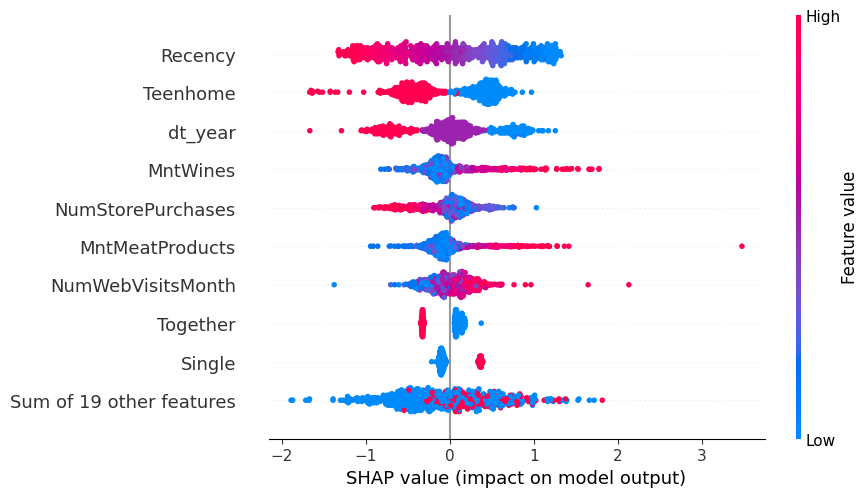

In [99]:
shap.plots.beeswarm(shap_values)


#For each group, the colour of the points is determined by the feature value (i.e. higher feature values are redder).


**Recency is most influential feature for logistic regression model**

**The higher value of recency leads to prediction of negative outcome. This is explaining same affect we observed in interpretation of coeeficients of regression model.**

**The higher the value of teenhome the lower chance of accepting program**

**The more number of wines he purchased, more chance of acceting program**

**The more number of times user visit site, the higher chance of accepting program**


**All the features in y-axis are sorted by their importance**


# Partial Dependency Plot

Permutation explainer: 1566it [01:15, 18.91it/s]                          


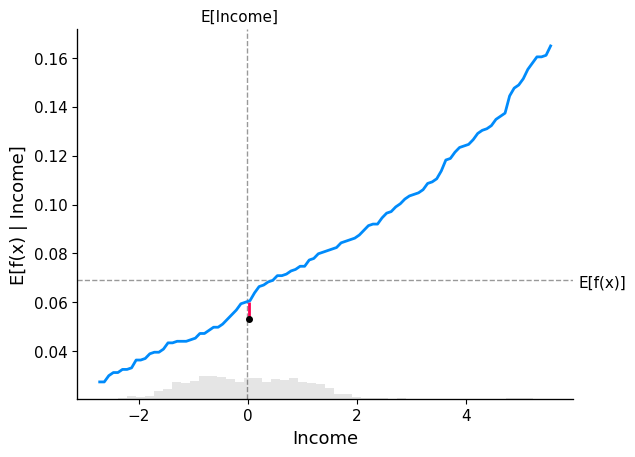

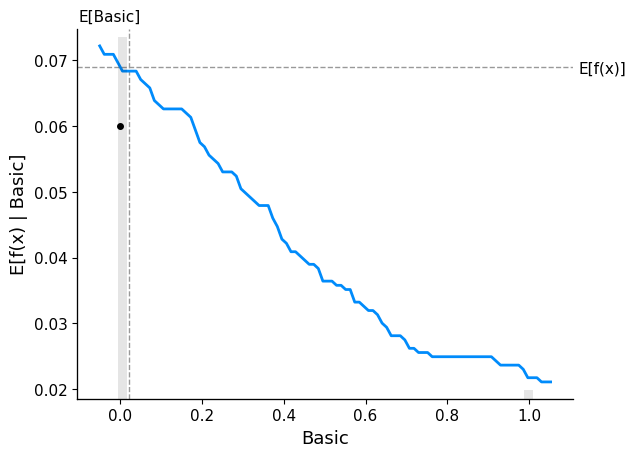

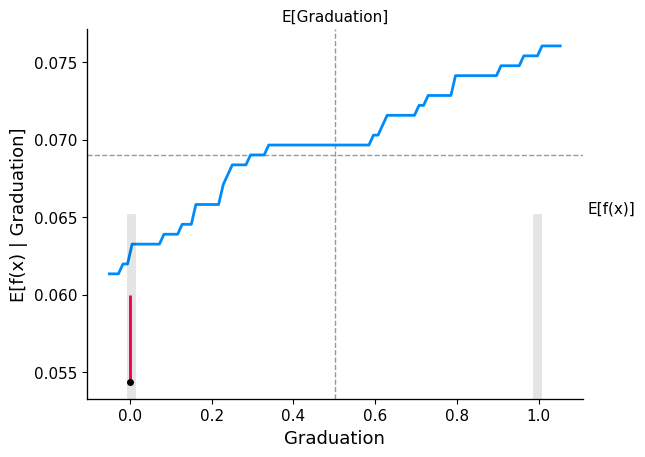

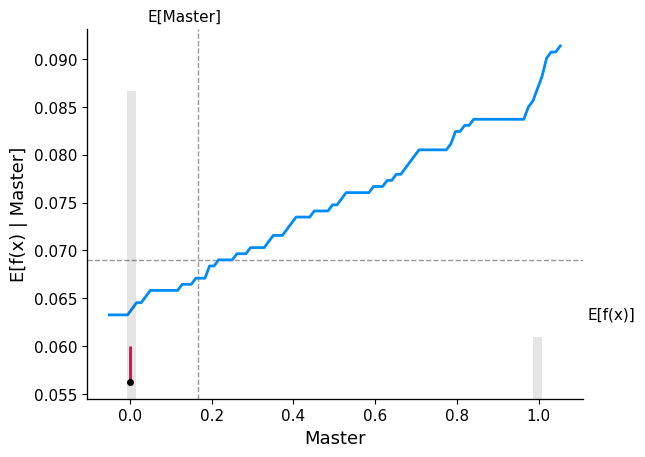

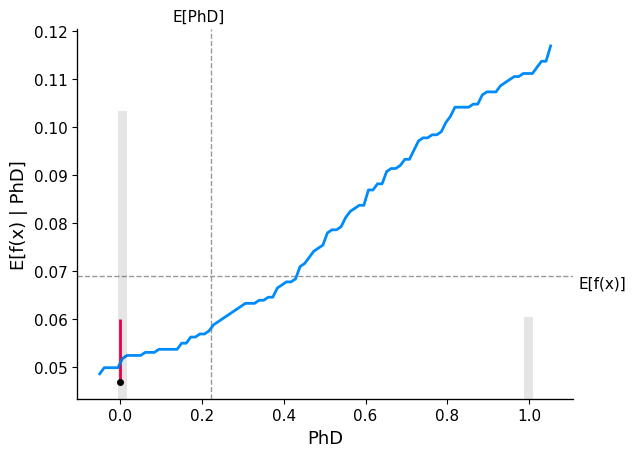

...

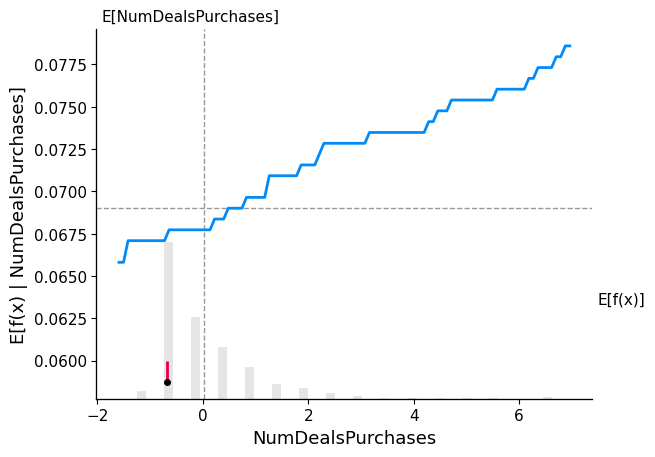

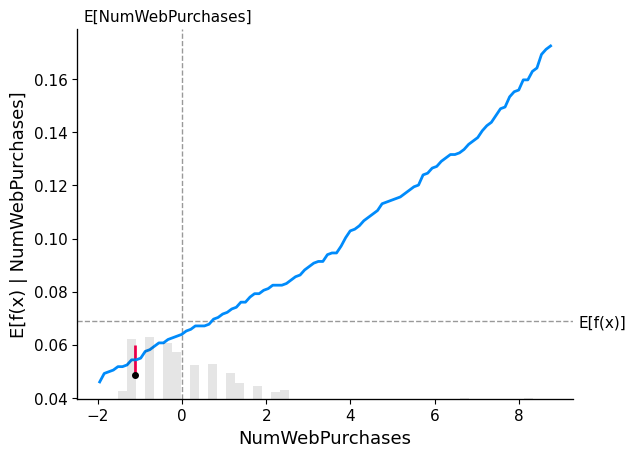

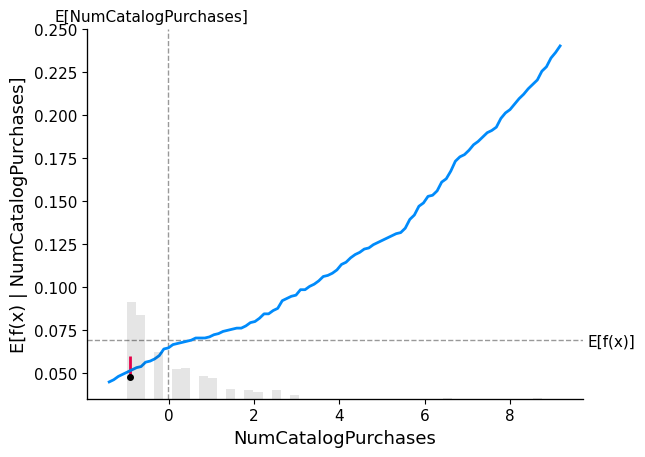

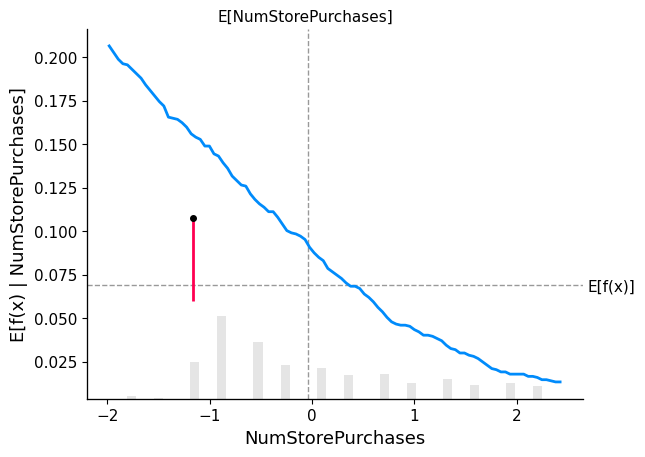

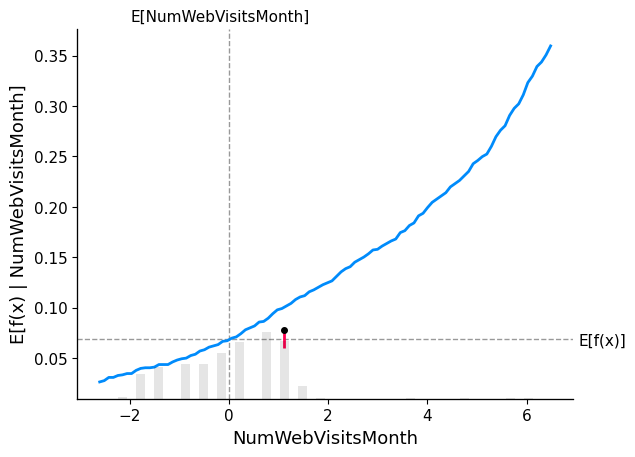

In [100]:


# SHAP explanation of a Linear Model
linear_explainer = shap.Explainer(logreg.predict, X_train)
linear_shap_values = linear_explainer(X_train)
for i in X_train.columns:
    # make a standard partial dependence plot
    sample_ind = 18
    shap.partial_dependence_plot(
        i,
        logreg.predict,
        X_train,
        model_expected_value=True,
        feature_expected_value=True,
        ice=False,
        shap_values=linear_shap_values[sample_ind : sample_ind + 1, :],
    )



# Interpretation of PDP 

Here the x-axis is the feature and the y-axis is the output as we vary the feature. The grey histogram is the distribution of variables in the dataset and the cross made by E[Feature], E[f(x)] is the expected values.

Let us take a feature of income

For the linear model the cross is made at approx E[f(x)] 0.2

So as the income increases the expected value also increases

Talking about the red line on the plot - When we give a sample as an input (sample_ind = 18) as an input to check the output. By plotting this we can see the difference between the model output from the expected value.

# Interpreting SHAP dependence plot 

The SHAP dependence plot shows the marginal effect one or two features have on the predicted outcome of a machine learning model. It tells whether the relationship between the target and a feature is linear, monotonic, or more complex. Let us interpret the SHAP dependence plot. Here in these graphs, we get a dot for every observation in our dataset.

As we can observe the linear model feature and its SHAP value have a linear relationship. If a feature has a positive impact on the prediction then the relationship will be directly proportional e.g. Mntfishproducts and if the feature dereases chances the relationship will be inversely proportional. e.g. dt_month

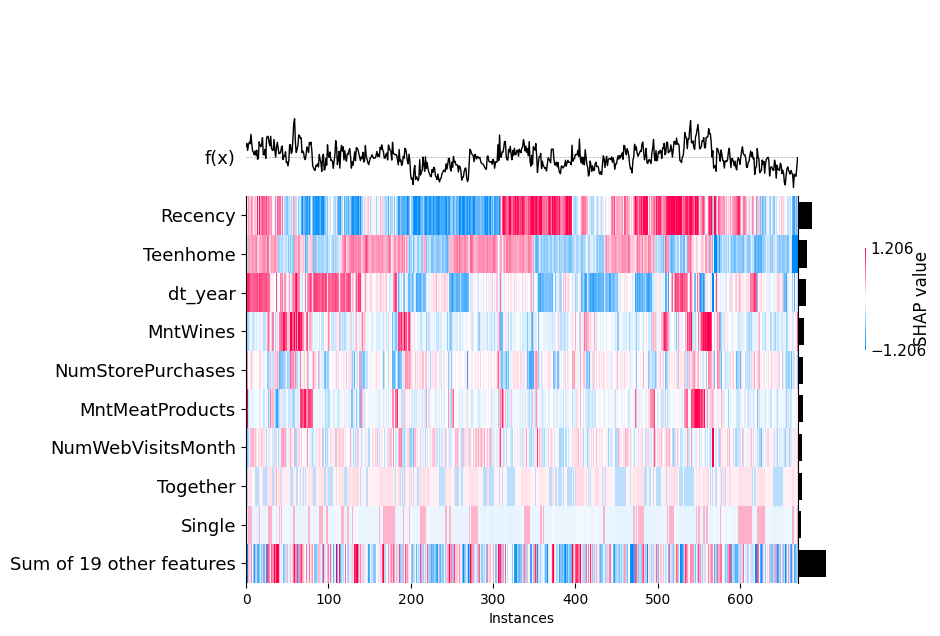

In [101]:
import shap
shap.plots.heatmap(shap_values)

# Heatmap Visualization 

This visualization is a summarization of the entire dataset on how each data point in every feature is affecting the prediction

Here the Y-axis is Features

and X-axis is Instance of that feature

The color of the instance defines if it had a positive effect or negative effect by its color. If the instance is red then it had a positive effect and if the instance is blue then it had a negative effect
The intensity of the color is directly proportional to the intensity of the effect. Deeper the color, the more impactful the feature is

Each feature has certain affect on decision given by model

# Interpreting tree model
# Waterfall plot

Permutation explainer: 1566it [00:48, 25.30it/s]


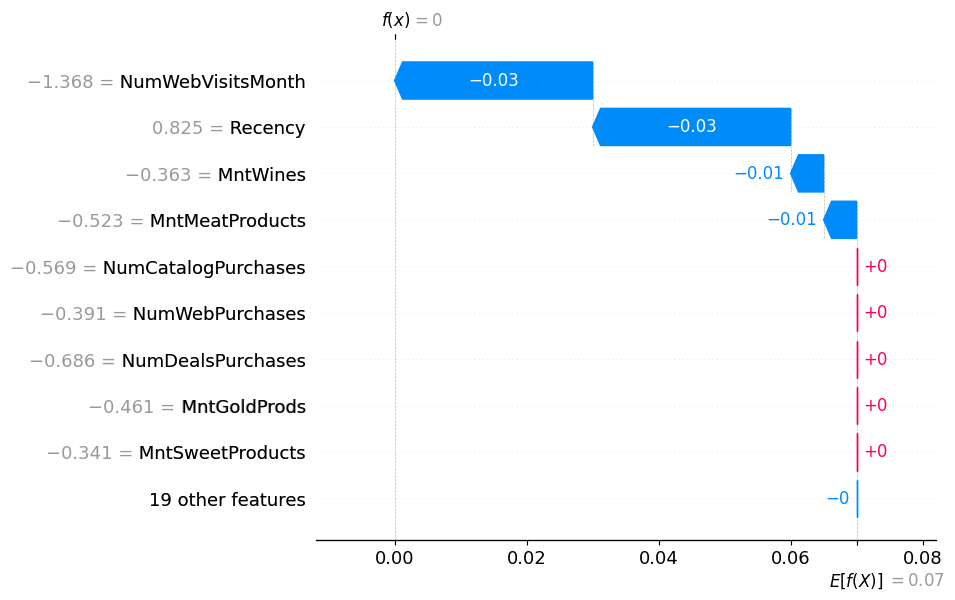

In [102]:
explainer = shap.Explainer(cl_tree.predict, X_train)
sv = explainer(X_train)

shap.plots.waterfall(sv[1])

***The waterfall plot is designed to visually display how the SHAP values (evidence) of each feature move the model output from our prior expectation under the background data distribution, to the final model prediction given the evidence of all the features***

Expected value or avaerge outcome value is 0.12 and current observation actual value is 1


1. PHD increased 0.34 units from average predicted value to get the actual value

2. income  was increased by 0.28 to get the actual value


**In this way, for the 1st observation, the predicted outcome is**

**0.12 + 0.02 - 0.02 - 0.02-0.02-0.04 +0.34+0.28... = 1**

unlike linear mode, in tree model, major contribution is from phd, income and mnt wines.

There will be a unique waterfall plot for every observation in our dataset. They can all be interpreted in the same way as above. In each case, the SHAP values tell us how the features have contributed to the prediction when compared to the mean prediction. 



# Beeswarm plot

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


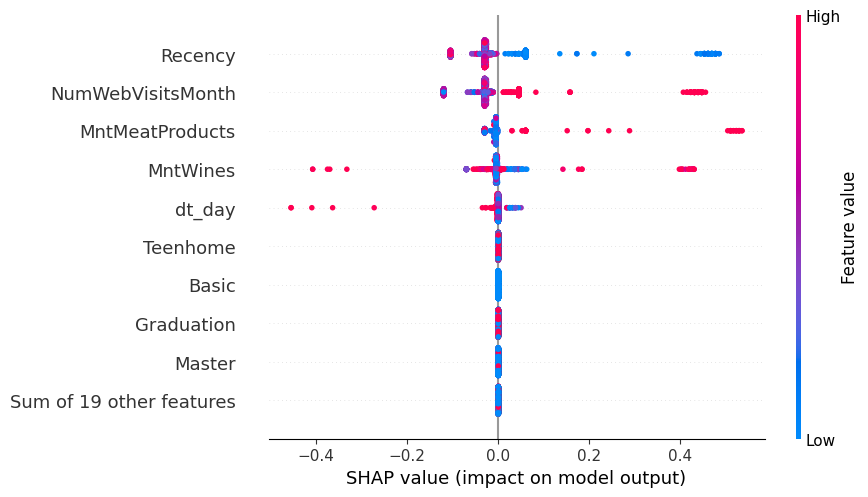

In [103]:
shap.plots.beeswarm(sv)


**For each group, the colour of the points is determined by the feature value (i.e. higher feature values are redder).**


**Recency is most influential feature for decision tree model**

**The higher value of recency leads to prediction of negative outcome. This is explaining same affect we observed in interpretation of coeeficients of regression model.**

**The higher the value of teenhome the lower chance of accepting program**

**The more amount of meat products purchased, more chance of acceting program**


**The more number of times user visit site, the higher chance of accepting program**

***Income is important but people with large income might or might not accept the program as we see red values on both sides.. Could be outliers existence. But lower income clearly explains the chance of denial to our program***



**All the features in y-axis are sorted by their importance**


#Partial Dependency Plot

Permutation explainer: 1566it [00:48, 25.53it/s]                          


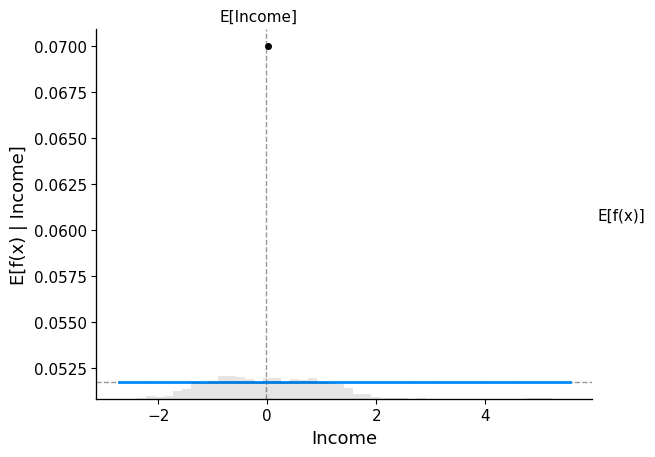

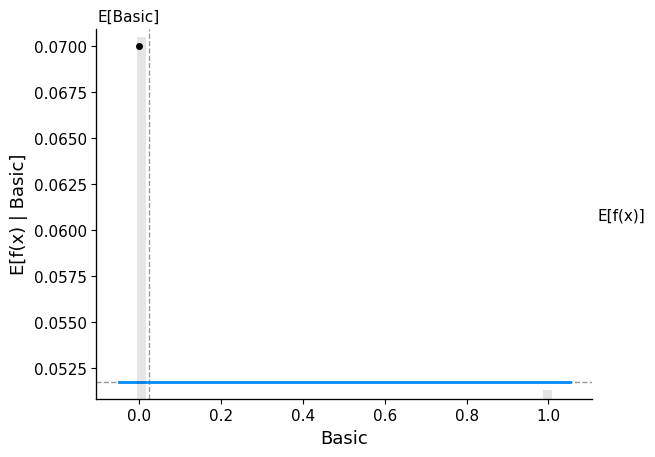

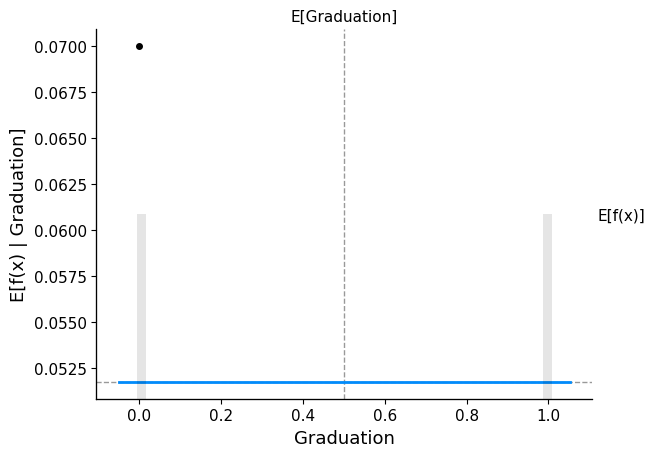

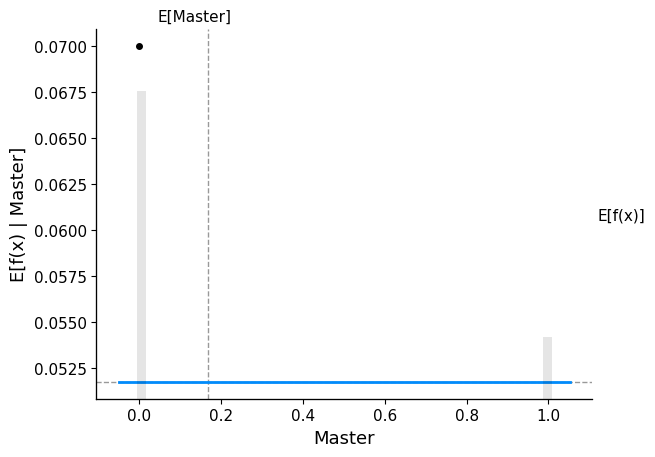

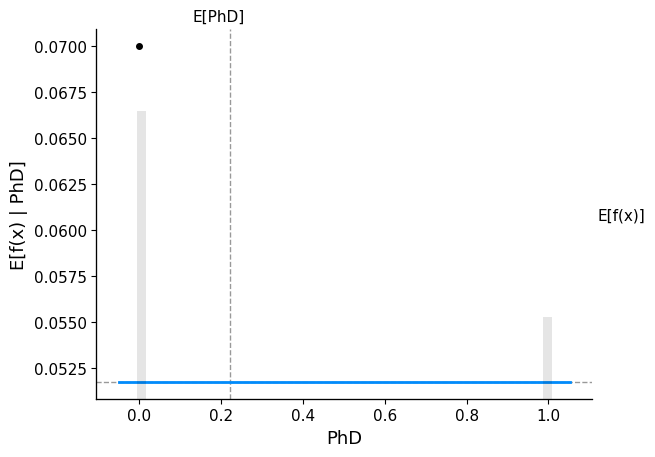

...

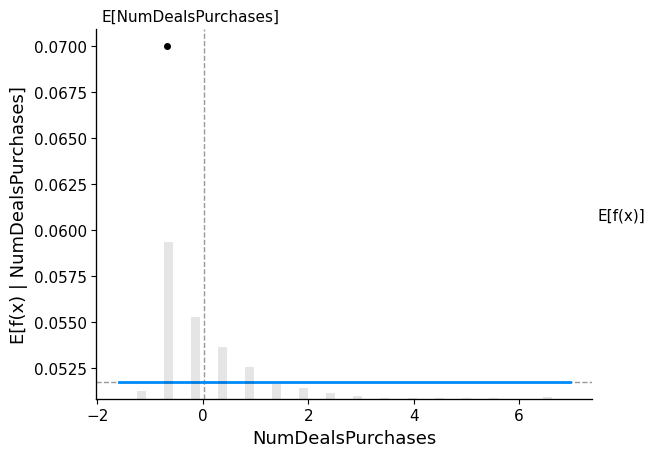

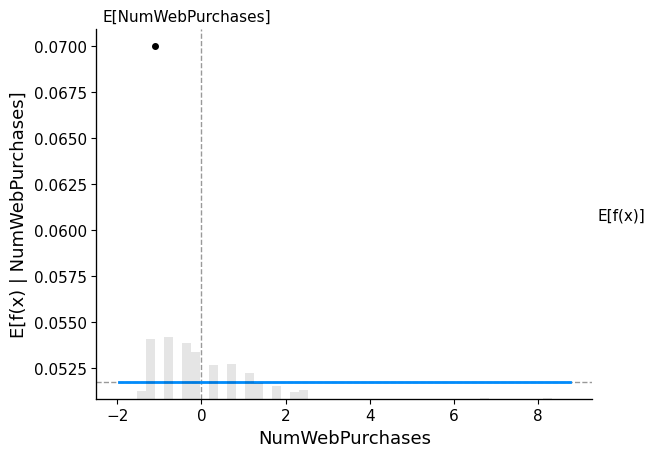

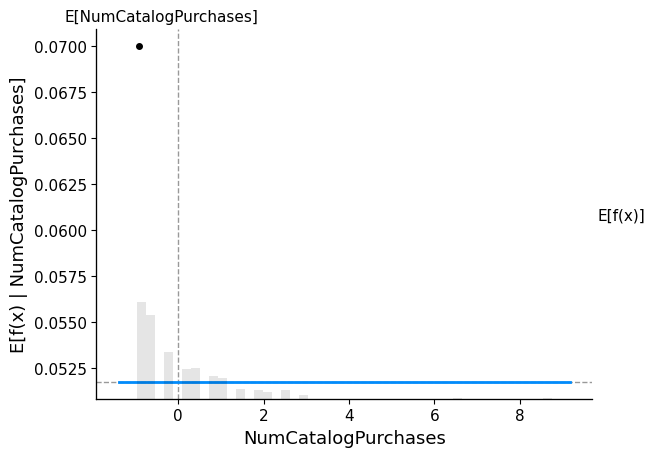

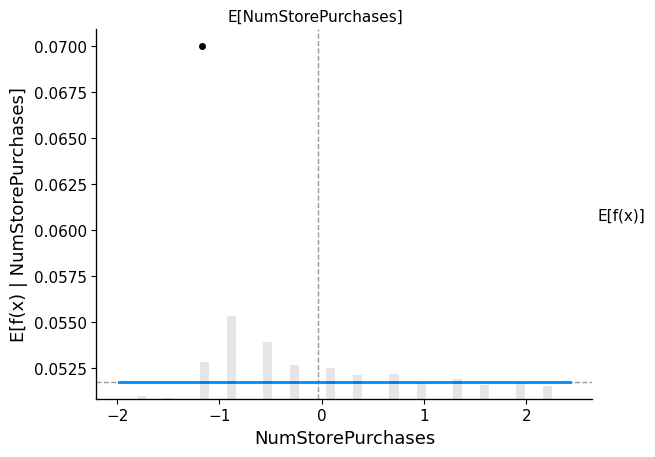

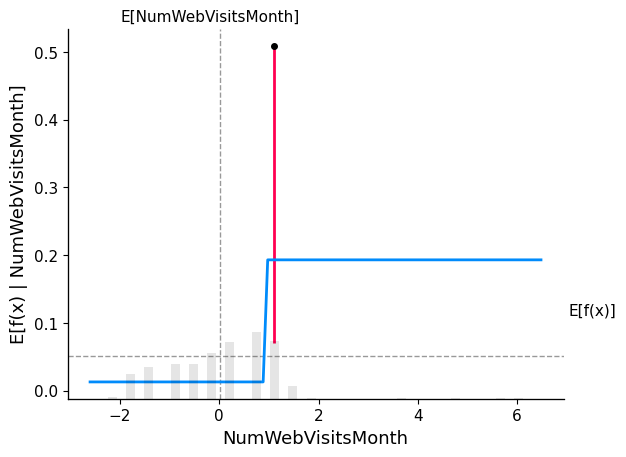

In [104]:


# SHAP explanation of a tree Model
linear_explainer = shap.Explainer(cl_tree.predict, X_train)
linear_shap_values = linear_explainer(X_train)
for i in X_train.columns:
    # make a standard partial dependence plot
    sample_ind = 18
    shap.partial_dependence_plot(
        i,
        cl_tree.predict,
        X_train,
        model_expected_value=True,
        feature_expected_value=True,
        ice=False,
        shap_values=linear_shap_values[sample_ind : sample_ind + 1, :],
    )



# Interpretation of PDP 

Here the x-axis is the feature and the y-axis is the output as we vary the feature. The grey histogram is the distribution of variables in the dataset and the cross made by E[Feature], E[f(x)] is the expected values.

Let us take a feature of income

For Tree-based model the cross is made at approx E[f(x)] 0.8

So as the income increases the expected value also increases

Talking about the red line on the plot - When we give a sample as an input (sample_ind = 18) as an input to check the output. By plotting this we can see the difference between the model output from the expected value.

#HeatMap

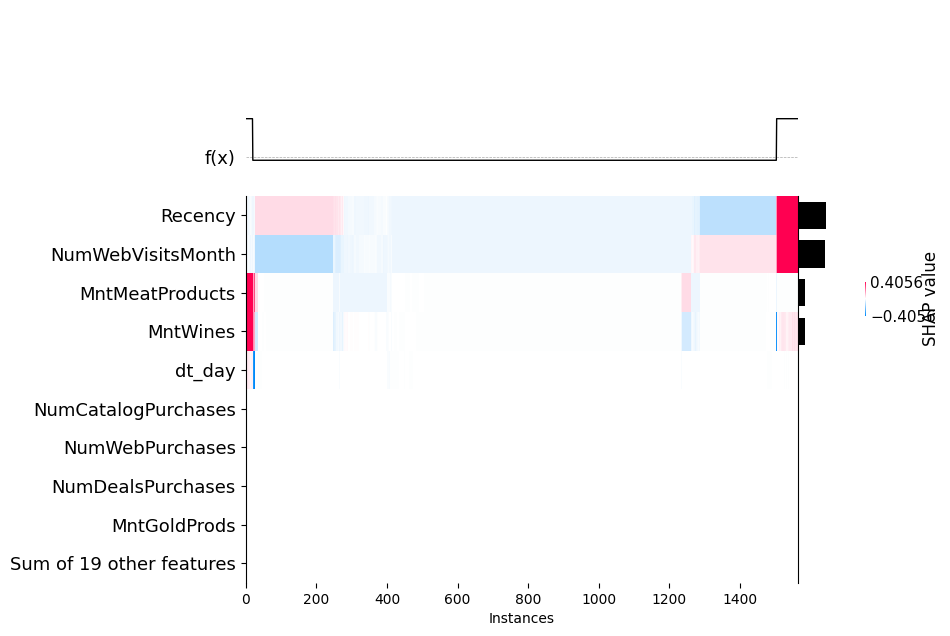

In [105]:
shap.plots.heatmap(sv)  

# Heatmap Visualization

This visualization is a summarization of the entire dataset on how each data point in every feature is affecting the prediction

Here the Y-axis is Features

and X-axis is Instance of that feature

The color of the instance defines if it had a positive effect or negative effect by its color. If the instance is red then it had a positive effect and if the instance is blue then it had a negative effect
The intensity of the color is directly proportional to the intensity of the effect. Deeper the color, the more impactful the feature is


the major impact on decision is from first 3 features only

# LIME Interpretation

In [106]:
from lime import lime_tabular
lime_linear_explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train), feature_names=X_train.columns, mode="classification"
)
idx = 18
np_x_test = np.array(X_test)
np_y_test = np.array(y_test)
print("Prediction : ", logreg.predict_proba(np_x_test[0].reshape(1, -1)))
print("Actual :     ", np_y_test[idx])

lime_linear_explanation = lime_linear_explainer.explain_instance(
    np_x_test[idx], logreg.predict_proba, num_features=np_x_test.shape[1]
)
lime_linear_explanation

Prediction :  [[0.33181402 0.66818598]]
Actual :      0


X does not have valid feature names, but LogisticRegression was fitted with feature names
X does not have valid feature names, but LogisticRegression was fitted with feature names


In [107]:
lime_linear_explanation.show_in_notebook()  # Display Results in Notebook


# Tree Model

In [108]:
lime_tree_explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train), feature_names=X_train.columns, mode="classification"
)
    

In [109]:
# Getting LIME interpretation for a sample data
idx = 18
np_x_test = np.array(X_test)
np_y_test = np.array(y_test)
print("Prediction : ", cl_tree.predict_proba(np_x_test[0].reshape(1, -1)))
print("Actual :     ", np_y_test[idx])

lime_tree_explanation = lime_linear_explainer.explain_instance(
    np_x_test[idx], cl_tree.predict_proba, num_features=np_x_test.shape[1]
)

     

Prediction :  [[0.82352941 0.17647059]]
Actual :      0


X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


In [110]:
lime_tree_explanation.show_in_notebook()  # Display Results in Notebook


# LIME (Local Interpretation Model-Agnostic Explanation) Analysis

LIME builds a surrogate model, i.e. converts a more complicated model (say a deep tree-based model into a simple linear model) around the data points in which we are interested and then it will try to make an approximation out of this simple model on the whole model. LIME builds a local model in such a way that it can interpret the whole Black-Box

LIME works well on tabular, text, image datasets - hence it works on different datasets

Let us Interpret our Linear model and Tree-based model on sample data (sample_index = 18) using LIME and try to understand what is happening under the hood. Please refer below for Visualizations of both models

As we can see LIME gives us information about the minimum and maximum values predicted by the model. The Color orange here represents positive and blue represents negative outcome

***Here for this sample dt_year, basic, married, numstorepurchases, numwebvisits had a positive outcome in linear model***

***The recency, complain, dt_year, mntfishproducts, dt_month had a positive outcome in tree model***

***In tree model, income, divorced, mntgold, mntsweet, basic had a negative income***

***In linear model, phd, mntwines, teenhome, divorced has a negative outcome ***

These interpretations were carried out locally in the region where of out sample data(sample_index = 18).


## Removed outliers which are higly deviated from mean

In [111]:

df1=df.copy()

def remove_outliers(df,columns,n_std):
    for col in columns:
        print('Working on column: {}'.format(col))
        
        mean = df[col].mean()
        sd = df[col].std()
        
        df = df[(df[col] <= mean+(n_std*sd))]
        
    return df

In [112]:
df2 = remove_outliers(df1, num_cols[1:],3) #excluding id column
df2=pd.get_dummies(df2)

Working on column: Income
Working on column: Recency
Working on column: MntWines
Working on column: MntFruits
Working on column: MntMeatProducts
Working on column: MntFishProducts
Working on column: MntSweetProducts
Working on column: MntGoldProds
Working on column: NumDealsPurchases
Working on column: NumWebPurchases
Working on column: NumCatalogPurchases
Working on column: NumStorePurchases
Working on column: NumWebVisitsMonth


In [113]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
cols_to_scale=['Income','Kidhome', 'Teenhome', 'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts',
       'MntFishProducts', 'MntSweetProducts', 'MntGoldProds','dt_year','dt_month','dt_day',
       'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',
       'NumStorePurchases', 'NumWebVisitsMonth']
df2[cols_to_scale]=scaler.fit_transform(df2[cols_to_scale])


In [114]:

X = df2.loc[:,~df2.columns.isin(['Response'])]

y = df2['Response']

#Spliting data into Training, Validation set and Test set

X_t, X_test, y_t, y_test = train_test_split(X, y, test_size=0.1, random_state=1)

X_train, X_val, y_train, y_val = train_test_split(X_t, y_t, test_size=0.15, random_state=1)

# Retraining Decision tree without outliers

In [115]:
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics
cl_tree=DecisionTreeClassifier(criterion='entropy',max_depth=10)
cl_tree=cl_tree.fit(X_train,y_train)

In [116]:
pred=cl_tree.predict(X_test)
Accuracy=round(metrics.accuracy_score(y_test,pred)*100,2)
print("The accuracy of the decision tree classiffier is:"+str(Accuracy)+ "%")

The accuracy of the decision tree classiffier is:90.37%


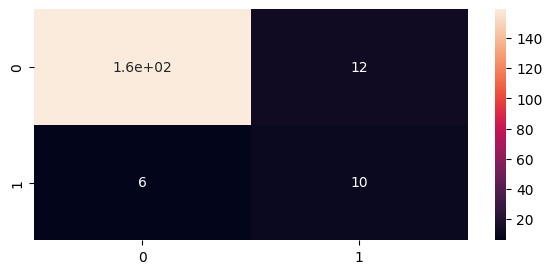

In [117]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
cm=confusion_matrix(y_test,pred)
%matplotlib inline
plt.figure(figsize=(7,3))
sns.heatmap(cm,annot=True)
plt.show()

# Logistic regression

In [118]:
from sklearn.linear_model import LogisticRegression
logi=LogisticRegression()
logi.fit(X_train,y_train)
predi=logi.predict(X_test)
#logistic_accuracy=round(logi.score(x_train,y_train)*100,2)
acc_scor=round(accuracy_score(y_test,predi)*100,2)
#print(acc_scor)
print(" The Accuracy of the logistic classification is:"+str(acc_scor)+"%")

 The Accuracy of the logistic classification is:90.91%


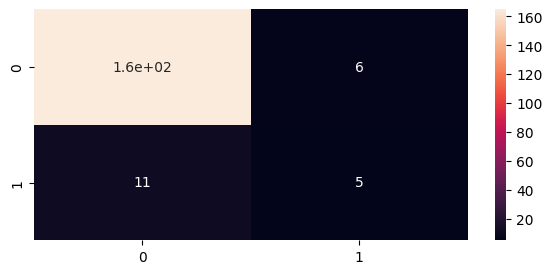

In [119]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
cm=confusion_matrix(y_test,predi)
%matplotlib inline
plt.figure(figsize=(7,3))
sns.heatmap(cm,annot=True)
plt.show()

# After removing outliers, the accuracy of both classifiers has been increased

# Imputations

In [120]:
def get_percent_missing(dataframe):
    
    percent_missing = dataframe.isnull().sum() * 100 / len(dataframe)
    missing_value_df = pd.DataFrame({'column_name': dataframe.columns,
                                     'percent_missing': percent_missing})
    return missing_value_df

In [121]:
def create_missing(dataframe, percent, col):
    dataframe.loc[dataframe.sample(frac = percent).index, col] = np.nan

In [122]:
df_number=df1.copy()
df_number = df_number.dropna()

In [123]:
df_number['number_copy_1_percent'] = df_number[['Income']]
df_number['number_copy_5_percent'] = df_number[['Income']]
df_number['number_copy_10_percent'] = df_number[['Income']]

In [124]:
create_missing(df_number, 0.01, 'number_copy_1_percent')
create_missing(df_number, 0.05, 'number_copy_5_percent')
create_missing(df_number, 0.1, 'number_copy_10_percent')
print(get_percent_missing(df_number))

                                   column_name  percent_missing
Income                                  Income         0.000000
Basic                                    Basic         0.000000
Graduation                          Graduation         0.000000
Master                                  Master         0.000000
PhD                                        PhD         0.000000
Married                                Married         0.000000
Together                              Together         0.000000
Single                                  Single         0.000000
Divorced                              Divorced         0.000000
Other                                    Other         0.000000
Kidhome                                Kidhome         0.000000
Teenhome                              Teenhome         0.000000
Recency                                Recency         0.000000
Complain                              Complain         0.000000
MntWines                              Mn

In [125]:
number_1_idx = list(np.where(df_number['number_copy_1_percent'].isna())[0])
number_5_idx = list(np.where(df_number['number_copy_5_percent'].isna())[0])
number_10_idx = list(np.where(df_number['number_copy_10_percent'].isna())[0])

In [126]:
print(f"Length of number_1_idx is {len(number_1_idx)} and it contains {(len(number_1_idx)/len(df_number['number_copy_1_percent']))*100}% of total data in column | Total rows: {len(df_number['number_copy_1_percent'])}")
print(f"Length of number_5_idx is {len(number_5_idx)} and it contains {(len(number_5_idx)/len(df_number['number_copy_1_percent']))*100}% of total data in column | Total rows: {len(df_number['number_copy_1_percent'])}")
print(f"Length of number_10_idx is {len(number_10_idx)} and it contains {(len(number_10_idx)/len(df_number['number_copy_1_percent']))*100}% of total data in column | Total rows: {len(df_number['number_copy_1_percent'])}")

Length of number_1_idx is 22 and it contains 0.9838998211091234% of total data in column | Total rows: 2236
Length of number_5_idx is 112 and it contains 5.008944543828265% of total data in column | Total rows: 2236
Length of number_10_idx is 224 and it contains 10.01788908765653% of total data in column | Total rows: 2236


# KNN Imputation

In [127]:
from sklearn.impute import KNNImputer


df_number1 = df_number[['Income','number_copy_10_percent']]
imputer = KNNImputer(n_neighbors=5)
imputed_number_df = pd.DataFrame(imputer.fit_transform(df_number1), columns = df_number1.columns)


In [128]:
df_number2 = df_number[['Income','number_copy_5_percent']]
imputer = KNNImputer(n_neighbors=5)
imputed_number_df2 = pd.DataFrame(imputer.fit_transform(df_number2), columns = df_number2.columns)


In [129]:
df_number3 = df_number[['Income','number_copy_1_percent']]
imputer = KNNImputer(n_neighbors=5)
imputed_number_df3 = pd.DataFrame(imputer.fit_transform(df_number3), columns = df_number3.columns)


In [130]:
imputed_number_df.sample(10)

,Income,number_copy_10_percent
61,48330.000000,48330.000000
176,53761.000000,53761.000000
794,61286.000000,61280.800000
1483,23724.000000,23724.000000
1394,7500.000000,7500.000000
1702,21645.000000,21645.000000
850,157733.000000,157733.000000
1964,52247.251354,52247.251354
662,33279.000000,33279.000000
2233,46310.000000,46310.000000


In [131]:
imputed_number_df3.sample(10)

,Income,number_copy_1_percent
831,22518.0,22518.0
34,18351.0,18351.0
2013,39791.0,39791.0
1449,63841.0,63841.0
352,30675.0,30675.0
1253,34377.0,34377.0
515,16529.0,16529.0
1938,73113.0,73113.0
1697,81741.0,81741.0
1930,24711.0,24711.0


In [132]:
print(get_percent_missing(imputed_number_df))

                                   column_name  percent_missing
Income                                  Income              0.0
number_copy_10_percent  number_copy_10_percent              0.0


In [133]:
df_number['Income'].isnull().sum()

0

In [134]:
imputed_number_df['Income'].isnull().sum()

0

In [135]:
import sklearn.metrics as metrics

def getscores(y,yhat):
    mae = metrics.mean_absolute_error(y, yhat)
    mse = metrics.mean_squared_error(y, yhat)
    rmse = np.sqrt(mse) # or mse**(0.5)  
    r2 = metrics.r2_score(y,yhat)

    print("Results :")
    print("MAE:",mae)
    print("MSE:", mse)
    print("RMSE:", rmse)
    print("R-Squared:", r2)

In [136]:
getscores(imputed_number_df['Income'],imputed_number_df['number_copy_10_percent'])

Results :
MAE: 5.218067494171512
MSE: 6755.9549672253725
RMSE: 82.19461641266642
R-Squared: 0.9999852568361259


In [137]:
getscores(imputed_number_df2['Income'],imputed_number_df2['number_copy_5_percent'])

Results :
MAE: 1.6223613595706596
MSE: 217.4007871198531
RMSE: 14.744517188428148
R-Squared: 0.999999525577739


In [138]:
getscores(imputed_number_df3['Income'],imputed_number_df3['number_copy_1_percent'])

Results :
MAE: 0.7768336314847927
MSE: 720.6081753130586
RMSE: 26.84414601571558
R-Squared: 0.9999984274548204


# Imputation By Mean

In [139]:
from sklearn.impute import SimpleImputer
imp_mean = SimpleImputer( strategy='mean') 

In [140]:
df_number1 = df_number[['Income','number_copy_10_percent']]
imputer =  SimpleImputer( strategy='mean') 
imputed_number_df = pd.DataFrame(imputer.fit_transform(df_number1), columns = df_number1.columns)


In [141]:
getscores(imputed_number_df['Income'],imputed_number_df['number_copy_10_percent'])

Results :
MAE: 1753.6593597734645
MSE: 45426031.46394075
RMSE: 6739.883638753769
R-Squared: 0.900869169604004


In [142]:
df_number2 = df_number[['Income','number_copy_5_percent']]

imputer =  SimpleImputer( strategy='mean') 
imputed_number_df2 = pd.DataFrame(imputer.fit_transform(df_number2), columns = df_number2.columns)


In [143]:
getscores(imputed_number_df2['Income'],imputed_number_df2['number_copy_5_percent'])

Results :
MAE: 861.7101499174873
MSE: 20131289.863042105
RMSE: 4486.7905971910595
R-Squared: 0.9560685488748891


In [144]:
df_number3 = df_number[['Income','number_copy_1_percent']]

imputer =  SimpleImputer( strategy='mean') 
imputed_number_df3 = pd.DataFrame(imputer.fit_transform(df_number2), columns = df_number3.columns)


In [145]:
getscores(imputed_number_df3['Income'],imputed_number_df3['number_copy_1_percent'])

Results :
MAE: 861.7101499174873
MSE: 20131289.863042105
RMSE: 4486.7905971910595
R-Squared: 0.9560685488748891


# Ranges


In [146]:
df.max()

Income                 162397.0
Basic                       1.0
Graduation                  1.0
Master                      1.0
PhD                         1.0
Married                     1.0
Together                    1.0
Single                      1.0
Divorced                    1.0
Other                       1.0
Kidhome                     2.0
Teenhome                    2.0
Recency                    99.0
Complain                    1.0
MntWines                 1493.0
MntFruits                 199.0
dt_year                  2014.0
dt_month                   12.0
dt_day                     31.0
MntMeatProducts          1725.0
MntFishProducts           259.0
MntSweetProducts          263.0
MntGoldProds              362.0
NumDealsPurchases          15.0
NumWebPurchases            27.0
NumCatalogPurchases        28.0
NumStorePurchases          13.0
NumWebVisitsMonth          20.0
Response                    1.0
dtype: float64

In [147]:
df.min()

Income                 1730.0
Basic                     0.0
Graduation                0.0
Master                    0.0
PhD                       0.0
Married                   0.0
Together                  0.0
Single                    0.0
Divorced                  0.0
Other                     0.0
Kidhome                   0.0
Teenhome                  0.0
Recency                   0.0
Complain                  0.0
MntWines                  0.0
MntFruits                 0.0
dt_year                2012.0
dt_month                  1.0
dt_day                    1.0
MntMeatProducts           0.0
MntFishProducts           0.0
MntSweetProducts          0.0
MntGoldProds              0.0
NumDealsPurchases         0.0
NumWebPurchases           0.0
NumCatalogPurchases       0.0
NumStorePurchases         0.0
NumWebVisitsMonth         0.0
Response                  0.0
dtype: float64

# Do the ranges of the predictor variables make sense ?

**Range of year of birth varies from 1893 to 1996** <br>

There are few people who are not alive practically can be considered as outliers

Year_Birth seems to normally distributed with majority of customers are born between 1965 and 1985  


**Education has Graduation , PhD  , Master  , 2n Cycle , Basic**  <br> 


Majority of customers are grauated or PHD in our program and few only are with Basic education

**Martial status of customers are Married , Together  , Single  , Divorced  , Widow  , Alone  , YOLO , Absurd** <br>

Majority of customers in our program are married and few only are widow

**Income ranges from 1730 to 666666.0** <br>

We have customers whose income is normally distributed between 1730 and 666666.0

**Kidhome and teenhome ranges from 0 to 2**<br>

Number of kids and teens in home are either 0,1 or 2

**Dt_Customer is when customer joined. This is distributed over last 3 years**<br>

dt_day and dt_month is roughly uniform

dt_year distribution shows more people joined in 2013 and others joined in 2012 and 2014

**Recency ranges from 0 to 99**<br>

number of recent transactions of our customers can be 0 to 99 and is uniformly distributed

**Amount generated from wines fruits meat sweet fish and gold products is normal**<br>

with few outliers, amount generated from products looks normal

**Number of deal , web catalog store purchases**<br>

**Number of times user viaited web per month varies 0 to 20**<br>

The range of web visits per month makes sense as few customers visited 20 times a month and few not visited the site

**Complain is 0 or 1 where 0 is not complained and vice versa**<br>


# Selecting model using Auto ML

In [148]:
!pip install h2o

%matplotlib inline
import random, os, sys
import h2o
import pandas
import pprint
import operator
import matplotlib
from h2o.estimators.glm import H2OGeneralizedLinearEstimator
from h2o.estimators.gbm import H2OGradientBoostingEstimator
from h2o.estimators.random_forest import H2ORandomForestEstimator
from h2o.estimators.deeplearning import H2ODeepLearningEstimator
from tabulate import tabulate
from h2o.automl import H2OAutoML

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 177.6/177.6 MB 6.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for h2o: filename=h2o-3.40.0.3-py2.py3-none-any.whl size=177694727 sha256=e2d047cf1517cddd6c9d2f16f98e120dbf8760a0bcbcbf0dfbf3ca5bdd27ad39
  Stored in directory: /root/.cache/pip/wheels/9a/54/b6/c9ab3e71309ef0000bbe39e715020dc151bbfc557784b7f4c9
Successfully built h2o


In [149]:
from tabulate import tabulate
from h2o.automl import H2OAutoML
from datetime import datetime
import pandas as pd
import logging
import csv
import optparse
import time
import json
from distutils.util import strtobool
import psutil
import numpy as np

In [150]:
# Setting up maximum runtime and memory for the AutoML
min_mem_size = 6
run_time = 222
pct_memory = 0.5
virtual_memory = psutil.virtual_memory()
min_mem_size = int(round(int(pct_memory * virtual_memory.available) / 1073741824, 0))
print(min_mem_size)


port_no = random.randint(5555, 55555)

#  h2o.init(strict_version_check=False,min_mem_size_GB=min_mem_size,port=port_no) # start h2o
try:
    h2o.init(
        strict_version_check=False, min_mem_size_GB=min_mem_size, port=port_no
    )  # start h2o
except:
    logging.critical("h2o.init")
    h2o.download_all_logs(dirname=logs_path, filename=logfile)
    h2o.cluster().shutdown()
    sys.exit(2)

5
Checking whether there is an H2O instance running at http://localhost:40839..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.18" 2023-01-17; OpenJDK Runtime Environment (build 11.0.18+10-post-Ubuntu-0ubuntu120.04.1); OpenJDK 64-Bit Server VM (build 11.0.18+10-post-Ubuntu-0ubuntu120.04.1, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.9/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmp3gkvvqly
  JVM stdout: /tmp/tmp3gkvvqly/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmp3gkvvqly/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:40839
Connecting to H2O server at http://127.0.0.1:40839 ... successful.


H2O_cluster_uptime:,05 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.40.0.3
H2O_cluster_version_age:,5 days
H2O_cluster_name:,H2O_from_python_unknownUser_im28bl
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,5 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


In [151]:
data = h2o.import_file( 'https://raw.githubusercontent.com/maheshsai252/DatasetsForDSCourse/main/superstore_data.csv' )
x = ['Id',
 'Year_Birth',
 'Education',
 'Marital_Status',
 'Income',
 'Kidhome',
 'Teenhome',
 'Dt_Customer',
 'Recency',
 'MntWines',
 'MntFruits',
 'MntMeatProducts',
 'MntFishProducts',
 'MntSweetProducts',
 'MntGoldProds',
 'NumDealsPurchases',
 'NumWebPurchases',
 'NumCatalogPurchases',
 'NumStorePurchases',
 'NumWebVisitsMonth',
 'Complain']

y='Response'

data["Response"] = data["Response"].asfactor() #converting response variable to categorical to generate appropriate metrics 


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [152]:
# Set up AutoML
run_time=333
aml = H2OAutoML(max_runtime_secs=run_time)

In [153]:
model_start_time = time.time()
pct_rows = 0.80  # Setting up the data split between training and test dataset.

train,test = data.split_frame([pct_rows])  
aml.train(x=x,y=y,training_frame=train) 

AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


key,value
Stacking strategy,cross_validation
Number of base models (used / total),6/8
# GBM base models (used / total),2/4
# XGBoost base models (used / total),2/2
# DRF base models (used / total),1/1
# GLM base models (used / total),1/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,Random
Metalearner nfolds,5
Metalearner fold_column,None


In [154]:
print(aml.leaderboard)


model_id                                                      auc    logloss     aucpr    mean_per_class_error      rmse        mse
StackedEnsemble_AllModels_1_AutoML_1_20230409_234051     0.882931   0.282541  0.546231                0.217701  0.299131  0.0894792
StackedEnsemble_AllModels_2_AutoML_1_20230409_234051     0.880519   0.284839  0.54101                 0.220889  0.300001  0.0900009
StackedEnsemble_AllModels_3_AutoML_1_20230409_234051     0.880317   0.284514  0.554122                0.216475  0.299493  0.089696
StackedEnsemble_BestOfFamily_3_AutoML_1_20230409_234051  0.879873   0.285342  0.540845                0.206186  0.299609  0.0897653
StackedEnsemble_BestOfFamily_4_AutoML_1_20230409_234051  0.879648   0.284313  0.55075                 0.20627   0.29904   0.0894251
StackedEnsemble_BestOfFamily_1_AutoML_1_20230409_234051  0.879596   0.288161  0.525399                0.225867  0.301997  0.0912023
StackedEnsemble_BestOfFamily_2_AutoML_1_20230409_234051  0.879363   0.285147 

# Finding Best Model with AutoML

In [155]:
best_model = h2o.get_model(aml.leaderboard[0,'model_id'])

best_model.algo


'stackedensemble'

In [156]:
model_index = 0
glm_index = 0
glm_model = ""
aml_leaderboard_df = aml.leaderboard.as_data_frame()
models_dict = {}
for m in aml_leaderboard_df["model_id"]:
    models_dict[m] = model_index
    if "StackedEnsemble" not in m:
        break
    model_index = model_index + 1

for m in aml_leaderboard_df["model_id"]:
    if "GLM" in m:
        models_dict[m] = glm_index
        break
    glm_index = glm_index + 1
models_dict

{'StackedEnsemble_AllModels_1_AutoML_1_20230409_234051': 0,
 'StackedEnsemble_AllModels_2_AutoML_1_20230409_234051': 1,
 'StackedEnsemble_AllModels_3_AutoML_1_20230409_234051': 2,
 'StackedEnsemble_BestOfFamily_3_AutoML_1_20230409_234051': 3,
 'StackedEnsemble_BestOfFamily_4_AutoML_1_20230409_234051': 4,
 'StackedEnsemble_BestOfFamily_1_AutoML_1_20230409_234051': 5,
 'StackedEnsemble_BestOfFamily_2_AutoML_1_20230409_234051': 6,
 'GBM_grid_1_AutoML_1_20230409_234051_model_17': 7,
 'GLM_1_AutoML_1_20230409_234051': 56}

In [157]:
print(model_index)
best_model = h2o.get_model(aml.leaderboard[model_index, "model_id"])

7


Best Model is Tree based GBM according to Auto ML

In [158]:
best_model.algo


'gbm'

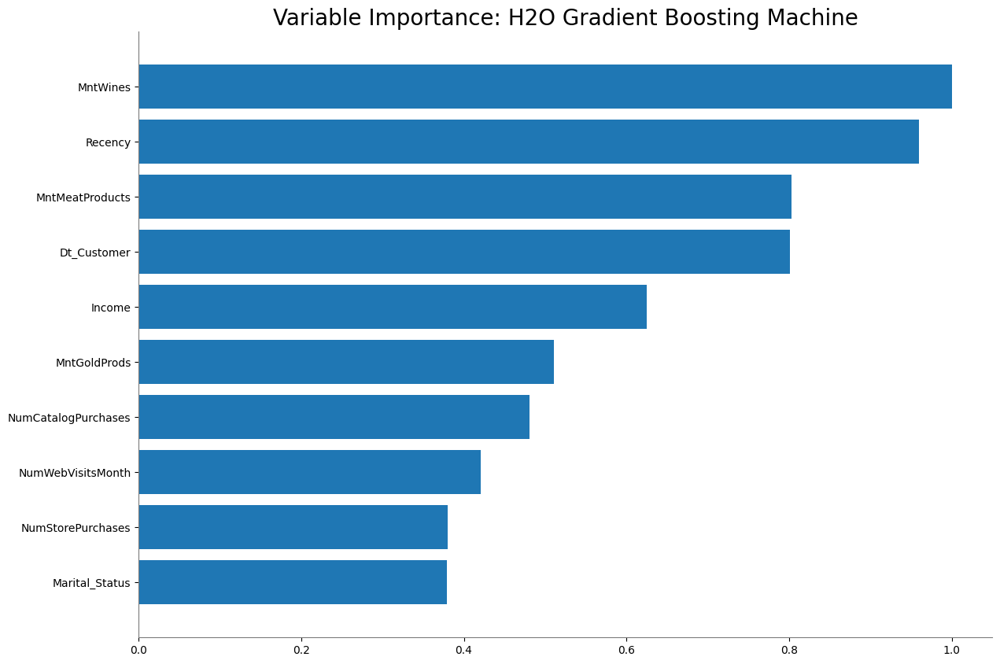

<Figure size 640x480 with 0 Axes>

In [159]:
if best_model.algo in [
    "gbm",
    "drf",
    "xrt",
    "xgboost",
]:  # Importance of all the variables in GBM algorithm.
    best_model.varimp_plot()

"is not" with a literal. Did you mean "!="?
"is not" with a literal. Did you mean "!="?
"is not" with a literal. Did you mean "!="?


56
glm


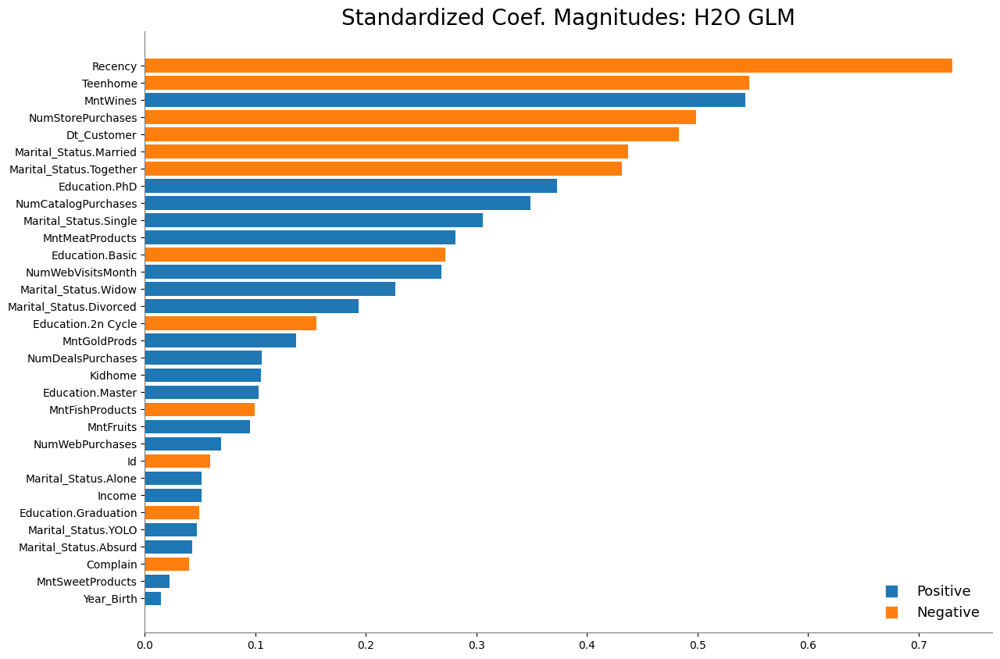

In [160]:
if glm_index is not 0:
    print(glm_index)
    glm_model = h2o.get_model(aml.leaderboard[glm_index, "model_id"])
    print(glm_model.algo)
    glm_model.std_coef_plot()

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_2_AutoML_1_20230409_234051,0.866246,0.30271,0.5536,0.207011,0.304973,0.0930083,1050,0.203606,StackedEnsemble
StackedEnsemble_BestOfFamily_3_AutoML_1_20230409_234051,0.865974,0.307152,0.540446,0.205688,0.30586,0.0935502,1012,0.132963,StackedEnsemble
StackedEnsemble_BestOfFamily_1_AutoML_1_20230409_234051,0.864749,0.304085,0.527062,0.270269,0.309453,0.0957609,1897,0.056842,StackedEnsemble
StackedEnsemble_AllModels_1_AutoML_1_20230409_234051,0.864009,0.306691,0.53223,0.215686,0.306702,0.0940663,980,0.100288,StackedEnsemble
StackedEnsemble_AllModels_3_AutoML_1_20230409_234051,0.863912,0.303097,0.547199,0.277778,0.30559,0.0933853,1823,0.292523,StackedEnsemble
StackedEnsemble_BestOfFamily_2_AutoML_1_20230409_234051,0.863737,0.311282,0.52881,0.207011,0.3076,0.0946175,860,0.06635,StackedEnsemble
XGBoost_grid_1_AutoML_1_20230409_234051_model_20,0.863698,0.309555,0.511882,0.232298,0.313397,0.0982174,579,0.031609,XGBoost
GBM_grid_1_AutoML_1_20230409_234051_model_15,0.863679,0.30705,0.538277,0.248794,0.306029,0.0936537,363,0.036805,GBM
GBM_1_AutoML_1_20230409_234051,0.862337,0.302376,0.537659,0.261594,0.306535,0.0939635,2631,0.068258,GBM
GBM_grid_1_AutoML_1_20230409_234051_model_5,0.860352,0.303724,0.560392,0.249533,0.3041,0.0924766,466,0.044449,GBM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_AllModels_1_AutoML_1_20230409_234051

,0,1,Error,Rate
0,315.0,63.0,0.1667,(63.0/378.0)
1,18.0,50.0,0.2647,(18.0/68.0)
Total,333.0,113.0,0.1816,(81.0/446.0)


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

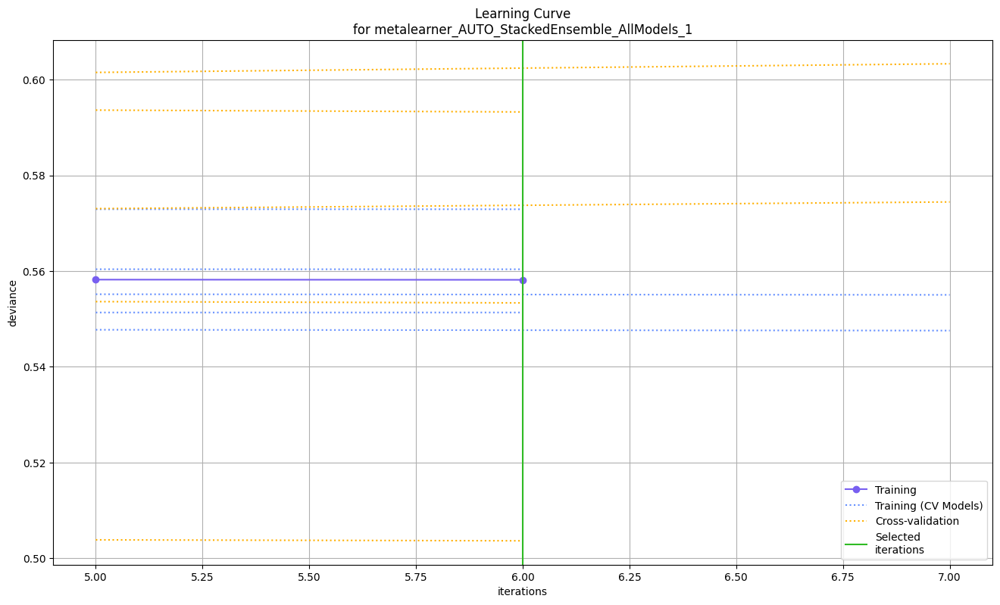

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

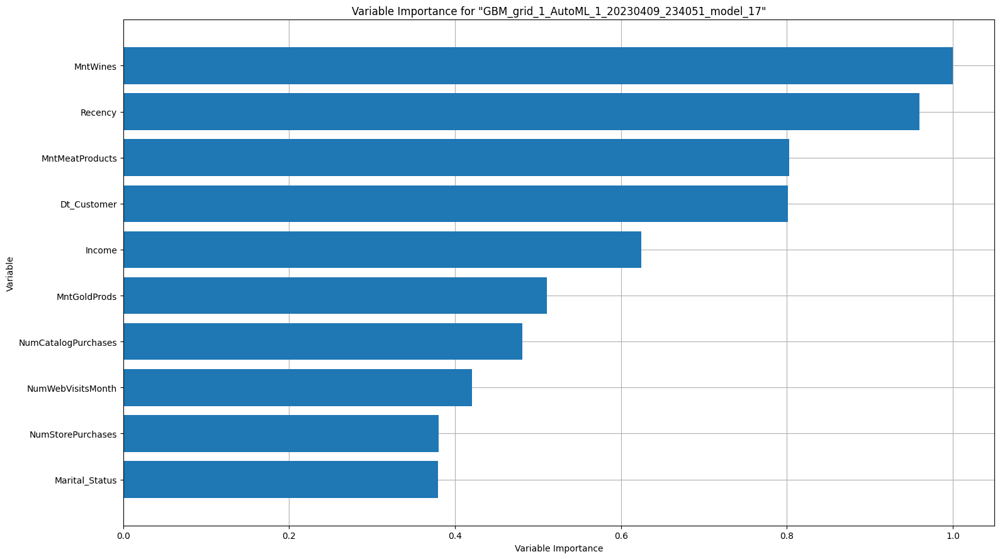

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

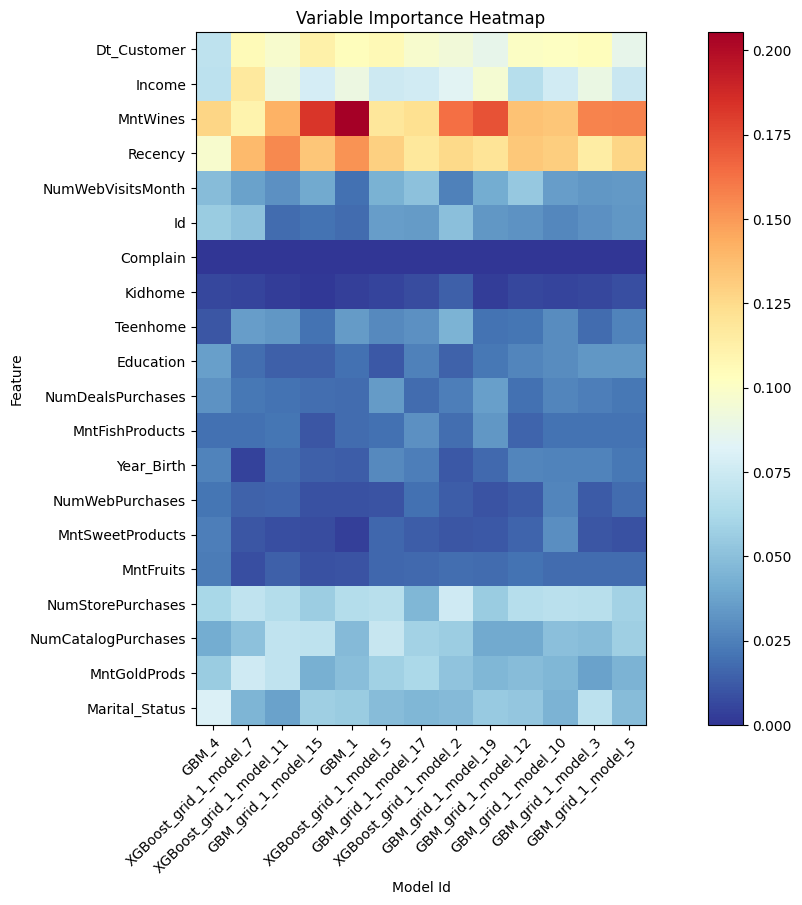

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

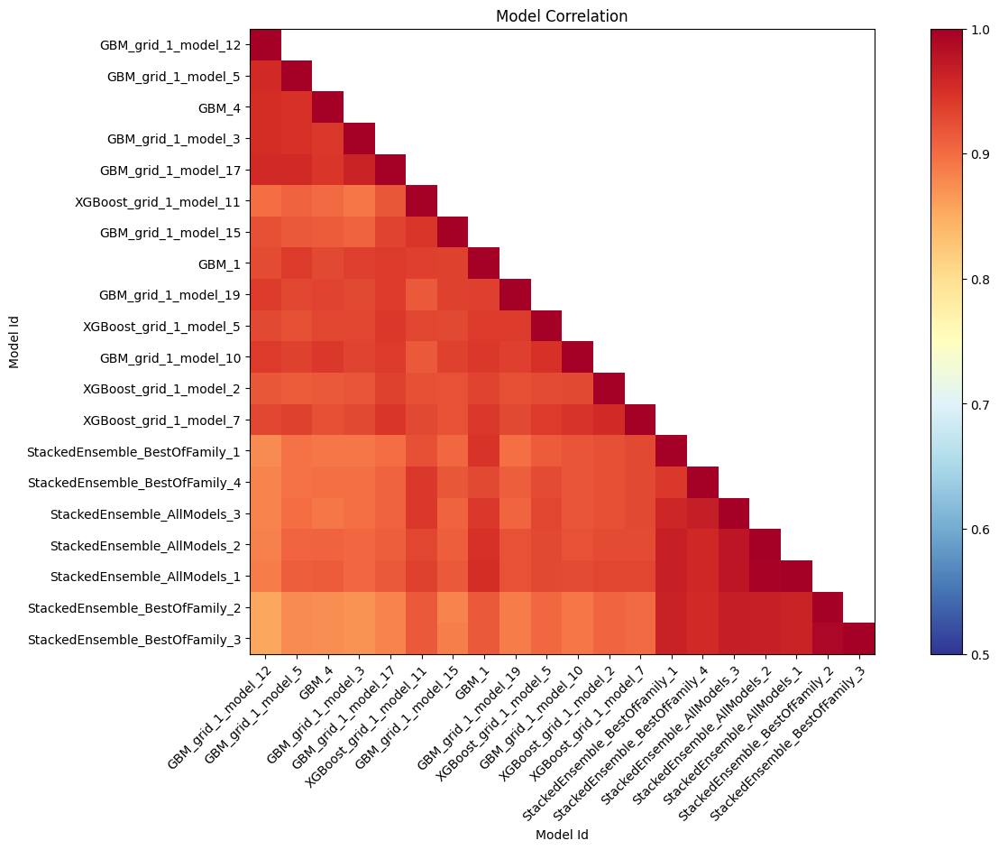

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

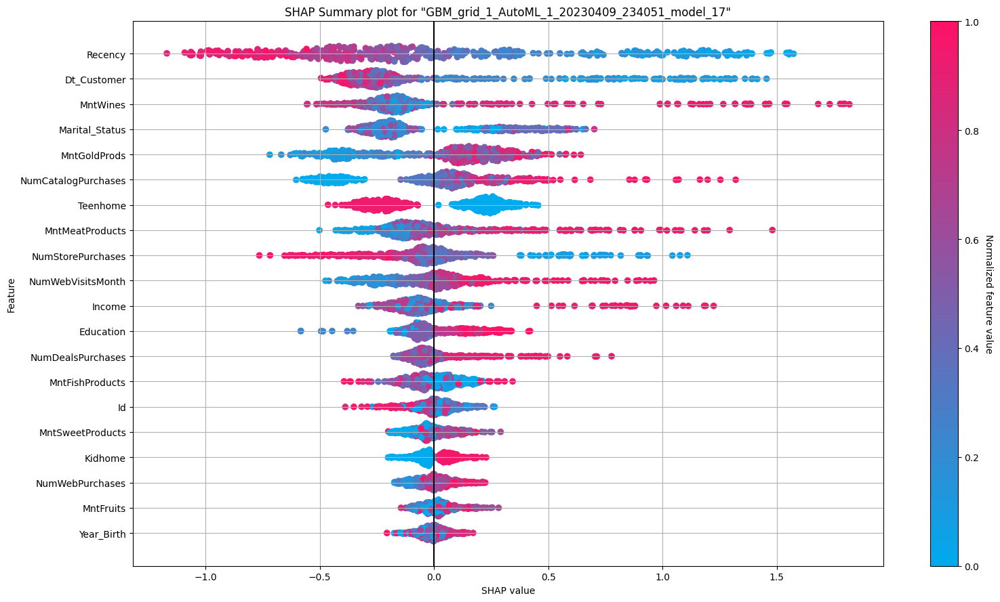

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

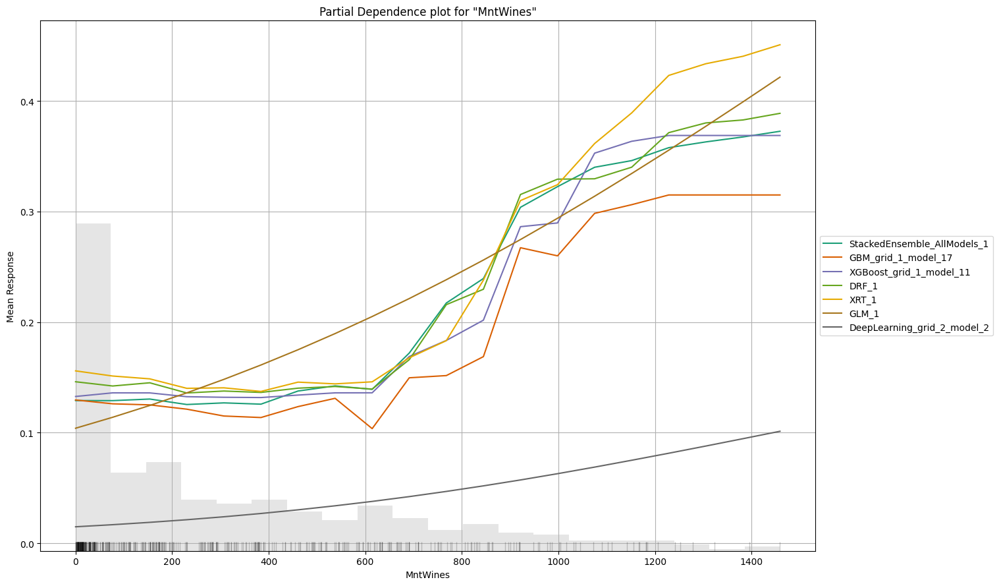

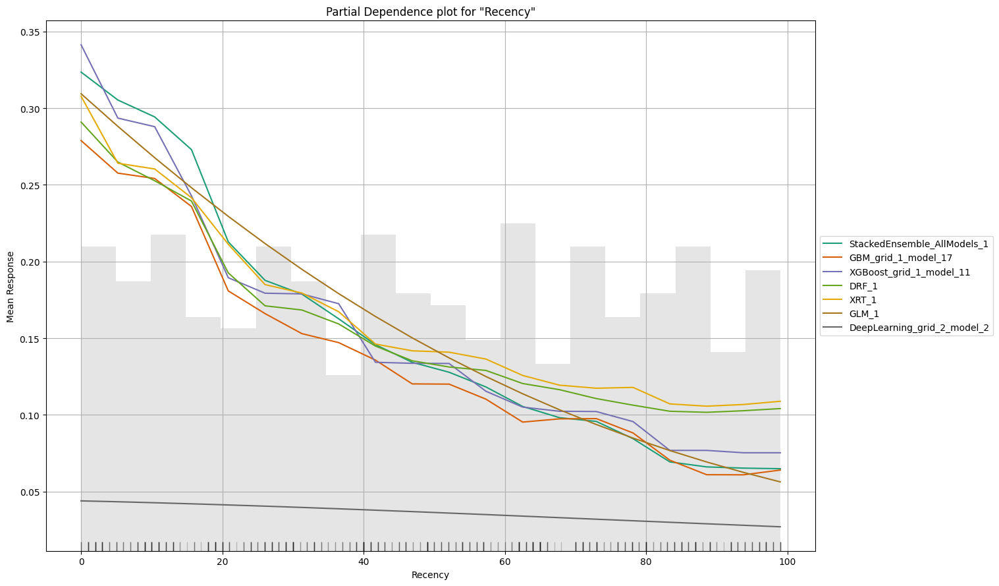

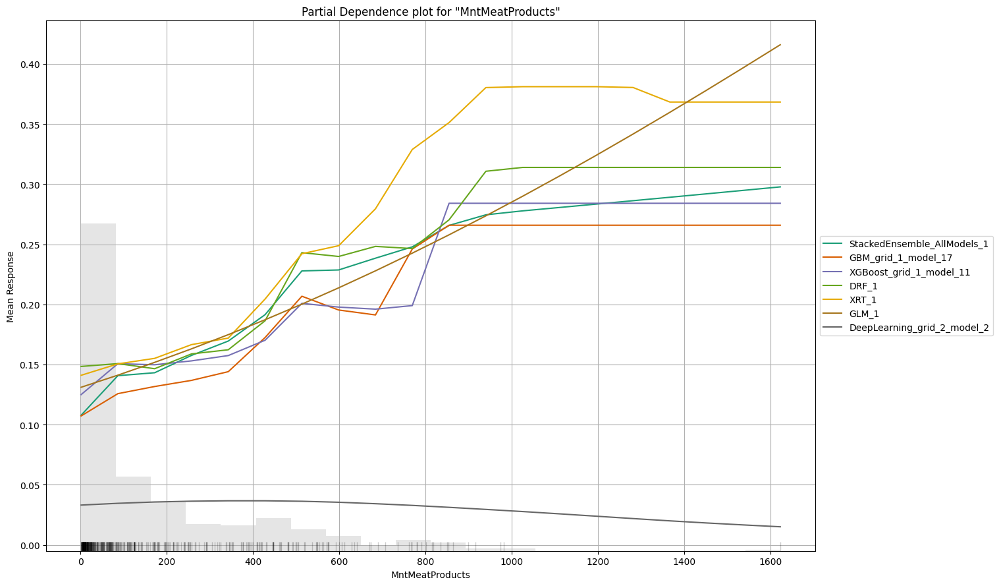

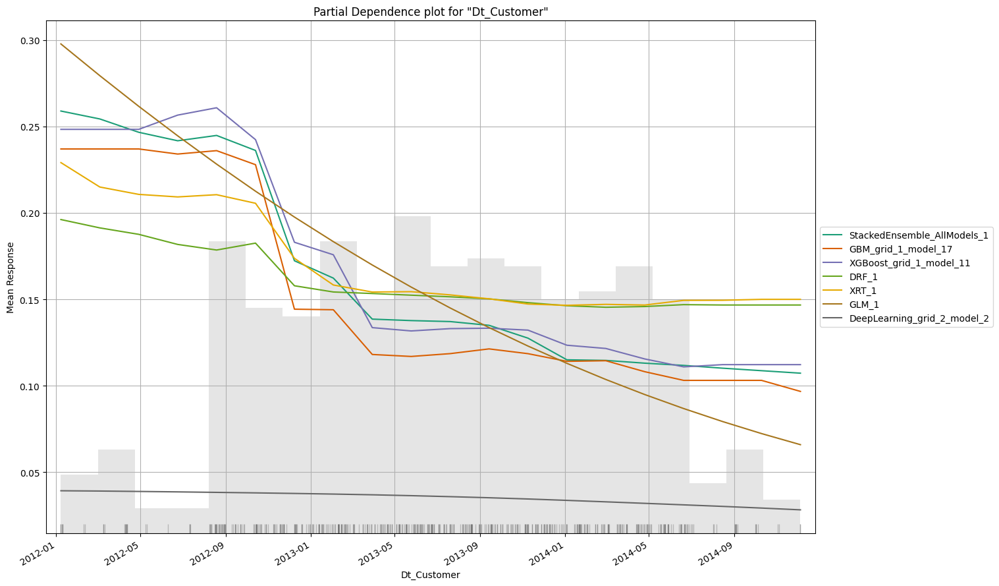

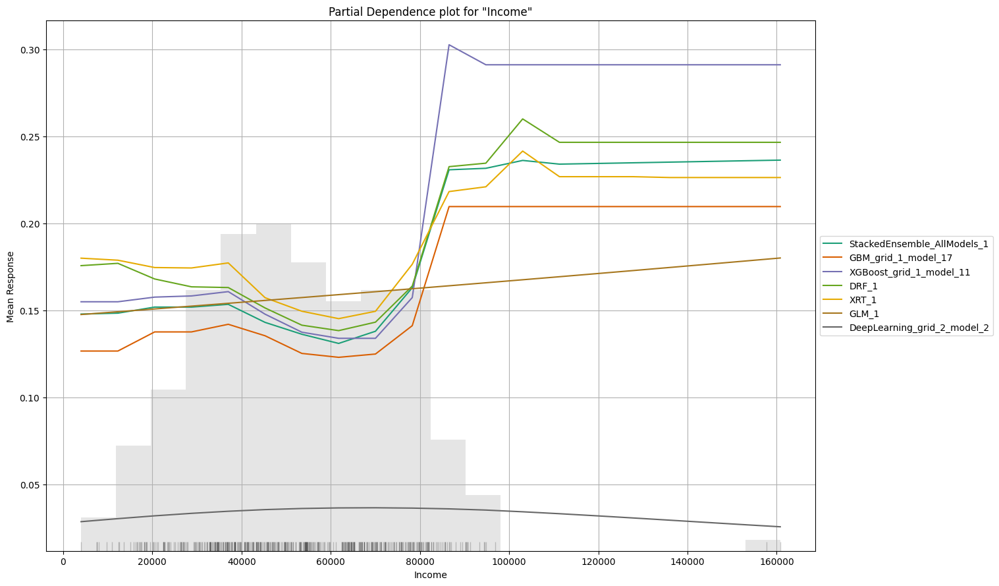

In [161]:
exa = aml.explain(test)


#Interpreting Best Model from AutoML

### Variable Importance

In the variable importance plot we can observe that the plot replicates the results which we see in Linear and tree model section. The variable importance has been scaled between 0 to 1 for the ease of understanding.

### SHAP Summary

From the SHAP summary diagram, we can interpret a few conclusions -

All the features are listed as per their importance in making the prediction, that is Recency is more significant followed by dt_customer, and so on. Hence, year_birth is the least significant predictor in our model.

The position on the SHAP value axis indicates the impact the feature has on the prediction either positive or negative. That is, the more the data point is away from the 0.0 shap value - the more its impact is.

**Recency is most influential feature for decision tree model**

**The higher value of recency leads to prediction of negative outcome. This is explaining same affect we observed in interpretation of coeeficients of regression model.**

**The customers who joined the site recently has high chance of approving program** 

**The higher the value of teenhome the lower chance of accepting program**

**The more amount of meat products purchased, more chance of acceting program**

**The higher education has high chance of accepting campaign**

**The more number of times user visit site, the higher chance of accepting program**

**Income is important feature. But people with large income might or might not accept the program as we see red values on both sides.. Could be outliers existence. But lower income clearly explains the chance of denial to our program**

**Younger people has high chance of accepting campaign**

###Partial Dependence Plot (PDP)

A partial dependence plot shows the marginal effect of a feature on the target(wine quality in our dataset). It is achieved by keeping all other variables constant and changing the value of one variable to get its PDP.

For Interpretation purposes, let us pick up the two most important variables - Recency and mntwines.

1. As we can see that when the rest of the variables are kept constant and a marginal change is made in recency, we can see the response decreases as recency increases. This could be interpreted as this increasing recency could be the deciding factor the range of 45-75 can be significant in the prediction of acceptance. 

2. Similarly when the rest of the variables are kept constant and a marginal change is made in mntwines we can observe the mean response of quality going up continuously with the increase in mntwines. Hence, it can be interpreted that the range of 650 to 800 is deciding factor in the prediction of acceptance. 

The computation of partial dependence plots is intuitive: The partial dependence function at a particular feature value represents the average prediction if we force all data points to assume that feature value.



### Comparision between SHAP, LIME, and Partial Dependence Plot Analysis

SHAP and LIME are two methods for interpreting the predictions of black-box machine learning models. While LIME builds a local interpretable model, SHAP uses the concept of Shapley values from game theory to calculate the contribution of each feature to the prediction without building a separate model. This makes SHAP more stable and reliable than LIME, which relies on local linear model assumptions.

PDP provides information about the impact of a single variable on the model's output by keeping all other variables fixed. In contrast, SHAP calculates the contribution of each variable to the prediction without fixing the others. LIME is similar to SHAP, but it focuses on the local region around a specific point of interest, providing information about the contribution of each variable to the output. Ultimately, the choice of the best interpretable method for a machine learning model depends on the specific needs and trade-offs involved.


# Removing predictors that are insignificant and re-training model

In [162]:
x_red = ['Id', 
 'Education',
 'Marital_Status',
 'Income',
 'Teenhome',
 'Dt_Customer',
 'Recency',
 'MntWines',
 'MntMeatProducts',
 'MntFishProducts',
 'MntGoldProds',
 'NumDealsPurchases',
 'NumCatalogPurchases',
 'NumStorePurchases',
 'NumWebVisitsMonth',
 'Complain',
 'Year_Birth','NumWebPurchases',
 ]



In [163]:
data = h2o.import_file( 'https://raw.githubusercontent.com/maheshsai252/DatasetsForDSCourse/main/superstore_data.csv' )

data["Response"] = data["Response"].asfactor() #converting response variable to categorical to generate appropriate metrics 
train,test = data.split_frame([.9])

gbm_red = H2OGradientBoostingEstimator(seed = 42, 
                                   model_id = 'default_gbm')

%time gbm_red.train(x = x_red, y = y, training_frame = train, validation_frame = test)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
gbm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%
CPU times: user 336 ms, sys: 26.8 ms, total: 363 ms
Wall time: 2.02 s


Model Details
=============
H2OGradientBoostingEstimator : Gradient Boosting Machine
Model Key: default_gbm


Model Summary: 
    number_of_trees    number_of_internal_trees    model_size_in_bytes    min_depth    max_depth    mean_depth    min_leaves    max_leaves    mean_leaves
--  -----------------  --------------------------  ---------------------  -----------  -----------  ------------  ------------  ------------  -------------
    50                 50                          16094                  5            5            5             7             30            20.92

ModelMetricsBinomial: gbm
** Reported on train data. **

MSE: 0.036121973863124705
RMSE: 0.1900578171586865
LogLoss: 0.1418220417727435
Mean Per-Class Error: 0.07813490622515777
AUC: 0.9888932507630553
AUCPR: 0.9536662655922441
Gini: 0.9777865015261107

Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.33501280169088943
       0     1    Error    Rate
-----  ----  ---  -------  -------------
0      1703  24   0.0139   (24.0/1727.0)
1      42    253  0.1424   (42.0/295.0)
Total  1745  277  0.0326   (66.0/2022.0)

Maximum Metrics: Maximum metrics at their respective thresholds
metric                       threshold    value     idx
---------------------------  -----------  --------  -----
max f1                       0.335013     0.884615  164
max f2                       0.217601     0.894804  207
max f0point5                 0.458782     0.926076  137
max accuracy                 0.338381     0.967359  163
max precision                0.973157     1         0
max recall                   0.059373     1         314
max specificity              0.973157     1         0
max absolute_mcc             0.335013     0.86621   164
max min_per_class_accuracy   0.219639     0.942373  206
max mean_per_class_accuracy  0.217601     0.943929  207
max tns                      0.973157     1727      0
max fns                      0.973157     294       0
max fps                      0.0067358    1727      399
max tps                      0.059373     295       314
max tnr                      0.973157     1         0
max fnr                      0.973157     0.99661   0
max fpr                      0.0067358    1         399
max tpr                      0.059373     1         314

Gains/Lift Table: Avg response rate: 14.59 %, avg score: 14.63 %
group    cumulative_data_fraction    lower_threshold    lift       cumulative_lift    response_rate    score      cumulative_response_rate    cumulative_score    capture_rate    cumulative_capture_rate    gain      cumulative_gain    kolmogorov_smirnov
-------  --------------------------  -----------------  ---------  -----------------  ---------------  ---------  --------------------------  ------------------  --------------  -------------------------  --------  -----------------  --------------------
1        0.0103858                   0.899997           6.85424    6.85424            1                0.923111   1                           0.923111            0.0711864       0.0711864                  585.424   585.424            0.0711864
2        0.020277                    0.868203           6.85424    6.85424            1                0.885288   1                           0.904661            0.0677966       0.138983                   585.424   585.424            0.138983
3        0.0301682                   0.833364           6.85424    6.85424            1                0.851938   1                           0.887374            0.0677966       0.20678                    585.424   585.424            0.20678
4        0.0400593                   0.797624           6.85424    6.85424            1                0.816644   1                           0.86991             0.0677966       0.274576                   585.424   585.424            0.274576
5        0.0504451                   0.770659           6.85424    6.85424            1                0.785288   1                           0.852488            0.0711864 

In [164]:
gbm_red.auc()


0.9888932507630553

In [165]:
from h2o.grid.grid_search import H2OGridSearch

hyper_parameters = {'max_depth':[1, 3, 5, 6, 7, 8, 9, 10, 12, 13, 15, 20, 25, 35]}

rf = H2ORandomForestEstimator(seed = 42,
                              stopping_rounds = 5, 
                              stopping_tolerance = 1e-4, 
                              stopping_metric = "auc",
                              model_id = 'rf')

grid_id = 'depth_grid'

search_criteria = {'strategy': "Cartesian"}

#Grid Search
rf_grid = H2OGridSearch(model = rf, 
                        hyper_params = hyper_parameters, 
                        grid_id = grid_id, 
                        search_criteria = search_criteria)

%time rf_grid.train(x = x_red, y = y, training_frame = train, validation_frame = test)

drf Grid Build progress: |███████████████████████████████████████████████████████| (done) 100%
CPU times: user 764 ms, sys: 32 ms, total: 796 ms
Wall time: 16.1 s


,max_depth,model_ids,logloss
,25.0,depth_grid_model_13,0.3269391
,35.0,depth_grid_model_14,0.3269391
,12.0,depth_grid_model_9,0.3271443
,13.0,depth_grid_model_10,0.3272310
,20.0,depth_grid_model_12,0.3279104
,10.0,depth_grid_model_8,0.3280040
,15.0,depth_grid_model_11,0.3287422
,9.0,depth_grid_model_7,0.3327676
,8.0,depth_grid_model_6,0.3360542
,7.0,depth_grid_model_5,0.3419474


In [166]:
sorted_rf_depth = rf_grid.get_grid(sort_by = 'auc',decreasing = True)
sorted_rf_depth.sorted_metric_table()

,,max_depth,model_ids,auc
0,,25.0,depth_grid_model_13,0.863200
1,,35.0,depth_grid_model_14,0.863200
2,,20.0,depth_grid_model_12,0.862556
3,,9.0,depth_grid_model_7,0.862197
4,,10.0,depth_grid_model_8,0.862054
5,,15.0,depth_grid_model_11,0.861410
6,,12.0,depth_grid_model_9,0.861266
7,,13.0,depth_grid_model_10,0.860765
8,,8.0,depth_grid_model_6,0.859762
9,,7.0,depth_grid_model_5,0.859189


In [167]:
hyper_parameters = {"max_depth":[13, 14, 15, 16, 17],
                    'sample_rate': [x/100. for x in range(20,101)]}

rf = H2ORandomForestEstimator(ntrees = 500,
                              seed = 42,
                              stopping_rounds = 5, 
                              stopping_tolerance = 1e-3, 
                              stopping_metric = "auc",
                              model_id = 'rf_grid')

grid_id = 'rf_random_grid'

search_criteria = {"strategy":"RandomDiscrete",
                   "max_models":100,
                   "max_runtime_secs":900,
                   "seed":42}

rf_grid = H2OGridSearch(model = rf, 
                        hyper_params = hyper_parameters, 
                        grid_id = grid_id, 
                        search_criteria = search_criteria)

%time rf_grid.train(x = x, y = y, training_frame = train, validation_frame = test)

drf Grid Build progress: |███████████████████████████████████████████████████████| (done) 100%
CPU times: user 3.65 s, sys: 248 ms, total: 3.9 s
Wall time: 1min 37s


,max_depth,sample_rate,model_ids,logloss
,13.0,0.72,rf_random_grid_model_84,0.3114609
,15.0,0.72,rf_random_grid_model_56,0.3123263
,16.0,0.43,rf_random_grid_model_38,0.3207829
,16.0,0.54,rf_random_grid_model_37,0.3227917
,13.0,0.36,rf_random_grid_model_3,0.3232395
,15.0,0.61,rf_random_grid_model_18,0.3252330
,13.0,0.93,rf_random_grid_model_41,0.3254069
,14.0,0.93,rf_random_grid_model_89,0.3254747
,16.0,0.61,rf_random_grid_model_26,0.3263262
,13.0,0.62,rf_random_grid_model_77,0.3266068


In [168]:
sorted_rf = rf_grid.get_grid(sort_by = 'auc', decreasing = True)
sorted_rf.sorted_metric_table()


,,max_depth,sample_rate,model_ids,auc
0,,13.0,0.36,rf_random_grid_model_3,0.883541
1,,16.0,0.43,rf_random_grid_model_38,0.879745
2,,17.0,0.42,rf_random_grid_model_21,0.879244
3,,13.0,0.72,rf_random_grid_model_84,0.875591
4,,15.0,0.72,rf_random_grid_model_56,0.873800
...,...,...,...,...,...
95,,16.0,0.68,rf_random_grid_model_92,0.815356
96,,15.0,0.27,rf_random_grid_model_25,0.815141
97,,13.0,0.68,rf_random_grid_model_16,0.810772
98,,14.0,0.95,rf_random_grid_model_57,0.807907


In [169]:
tuned_rf = sorted_rf.models[0]


In [170]:
tuned_rf_per = tuned_rf.model_performance(test)
tuned_rf_per.auc()

0.8835410399656211

In [171]:
tuned_rf_per.F1()


[[0.29123155540890167, 0.6419753086419754]]

# Hyperparameters of Random Forest:


**Max Depth:**

Depth upto which the tree can grow. This can help in reducing the varience with the cost of bias


**Sample rate:**

sample rate tells the quantity of data sampled to include in training model.

sample rate=1 means use entire data to train.

**The result from tuning is quite interesting as it performs well compared to default model. Tuning hyperparameters of random forest helped in increasing performance**

**There is noticable difference in metrics with removal of insignificant predictors**


### Comparision between SHAP, LIME, and Partial Dependence Plot Analysis

SHAP and LIME are two methods for interpreting the predictions of black-box machine learning models. While LIME builds a local interpretable model, SHAP uses the concept of Shapley values from game theory to calculate the contribution of each feature to the prediction without building a separate model. This makes SHAP more stable and reliable than LIME, which relies on local linear model assumptions.

PDP provides information about the impact of a single variable on the model's output by keeping all other variables fixed. In contrast, SHAP calculates the contribution of each variable to the prediction without fixing the others. LIME is similar to SHAP, but it focuses on the local region around a specific point of interest, providing information about the contribution of each variable to the output. Ultimately, the choice of the best interpretable method for a machine learning model depends on the specific needs and trade-offs involved.


#Conclusion 

We have performed the Data Cleaning and EDA 

    - Understood nature of data
    - Identified distributions
    - Handled missing values and outliers
    - Identified relations and significance of predictors
    - Understood various methods of imputating missing values

we have completed Modelling and Interpretation

    - Trained linear and tree based models
    - interpretated of models using LIME and SHAP values

we Used AutoML to find the best classifier and interpret the explanation of AutoML results

    - Trained auto ml model to identify best model and interpret results of best model
    - Tuned hyperparameters of models
    - Re-trained the model without outliers and observing the affect

LICENSE MIT License

Copyright (c) 2023 Sai Durga Mahesh Bandaru

Permission is hereby granted, free of charge, to any person obtaining a copy of this software and associated documentation files (the "Software"), to deal in the Software without restriction, including without limitation the rights to use, copy, modify, merge, publish, distribute, sublicense, and/or sell copies of the Software, and to permit persons to whom the Software is furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY, FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM, OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE SOFTWARE.